# Spaceborne-Ground Radar Matching (Methodology) 

In this tutorial, we demonstrate how to exploit GPM-API along with other radar software such
[xradar](https://docs.openradarscience.org/projects/xradar/en/stable/) and 
[wradlib](https://docs.wradlib.org/en/latest/) to match reflectivities measurements of spaceborne (SR) and ground (GR) radars.

We guide you step-by-step through the process of obtaining spatially and temporally coincident radar samples.

The procedure, based on [Schwaller and Morris (2011)](https://doi.org/10.1175/2010JTECHA1403.1) and adapted by [Warren, et. al. (2018)](https://doi.org/10.1175/JTECH-D-17-0128.1), involves:
- averaging SR reflectivities vertically along the SR beam between the half-power points of the GR sweep.
- averaging GR reflectivities horizontally within the SR beam's footprint.

The basic principle is illustrated in Fig. 2 of the original paper of Schwaller and Morris (2011).

![figure 2](https://raw.githubusercontent.com/ghiggi/gpm_api/main/docs/source/static/fig2_schwaller_morris_2011.png)


Warren et al. (2018) describe the method as follows:
*"[...] intersections between individual SR beams and GR elevation sweeps are identified and the reflectivity values from both  instruments are averaged within a spatial neighborhood around the intersection. 
Specifically, SR data are averaged in range over the width of the GR beam at the GR range of the intersection, while GR data are averaged in the range–azimuth plane within the footprint of the SR beam. 
The result is a pair of reflectivity measurements corresponding to approximately the same volume of atmosphere. [...]".*

This becomes clearer in Fig. 3:

![figure 3](https://raw.githubusercontent.com/ghiggi/gpm_api/main/docs/source/static/fig3_schwaller_morris_2011.png)


## Relevant software

To run this tutorial, it is necessary to install additional libraries which are not automatically required by GPM-API.
The libraries are 
[xradar](https://docs.openradarscience.org/projects/xradar/en/stable/), 
[wradlib](https://docs.wradlib.org/en/latest/), 
[geopandas](https://geopandas.org/en/stable/), 
[fsspec](https://filesystem-spec.readthedocs.io/en/latest/), 
[s3fs](https://s3fs.readthedocs.io/en/latest/) and 
[folium](https://python-visualization.github.io/folium/latest/). 
You can install them with terminal command `conda install -c conda-forge xradar wradlib geopandas fsspec s3fs folium`

If you have such libraries installed, you can start importing the required packages:

In [ ]:
import warnings

warnings.filterwarnings("ignore")
import datetime
from functools import reduce

import cartopy.crs as ccrs
import fsspec
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import wradlib as wrl
import xarray as xr
import xradar as xd
from shapely import Point

import gpm
from gpm.utils.gv import (
    convert_s_to_ku_band,
    retrieve_gates_projection_coordinates,
    xyz_to_antenna_coordinates,
)
from gpm.utils.remapping import reproject_coords
from gpm.utils.zonal_stats import PolyAggregator

np.set_printoptions(suppress=True)

## Load SR data with GPM-API

In this tutorial, we use a GPM DPR overpass over San Diego (USA) during the landfall of Tropical Storm Hilary in 2023. 

In [ ]:
start_time = datetime.datetime.strptime("2023-08-20 22:12:00", "%Y-%m-%d %H:%M:%S")
end_time = datetime.datetime.strptime("2023-08-20 22:13:45", "%Y-%m-%d %H:%M:%S")

Let's download the data

In [ ]:
product_type = "RS"
products = ["2A-DPR", "1B-Ku"]
version = 7
storage = "GES_DISC"

for product in products:
    gpm.download(
        product=product,
        product_type=product_type,
        version=version,
        storage=storage,
        start_time=start_time,
        end_time=end_time,
    )

All the available GPM 2A-DPR product files are already on disk.
Integrity checking of GPM files has completed.
All the available GPM 1B-Ku product files are already on disk.
Integrity checking of GPM files has completed.


Now let's open the GPM products and analyse the GPM overpass:

In [ ]:
ds_sr = gpm.open_dataset(
    product="2A-DPR",
    product_type=product_type,
    version=version,
    start_time=start_time,
    end_time=end_time,
    chunks={},
)

ds_l1b_sr = gpm.open_dataset(
    product="1B-Ku",
    product_type=product_type,
    version=version,
    start_time=start_time,
    end_time=end_time,
    chunks={},
)

ds_sr = ds_sr.compute()

'scan_mode' has not been specified. Default to FS.


In [ ]:
# Retrieve imporant info from L1B
ds_l1b_sr = ds_l1b_sr.compute()
beam_width_sr = ds_l1b_sr["crossTrackBeamWidth"]  # alongTrackBeamWidth
range_resolution = ds_l1b_sr["rangeBinSize"]

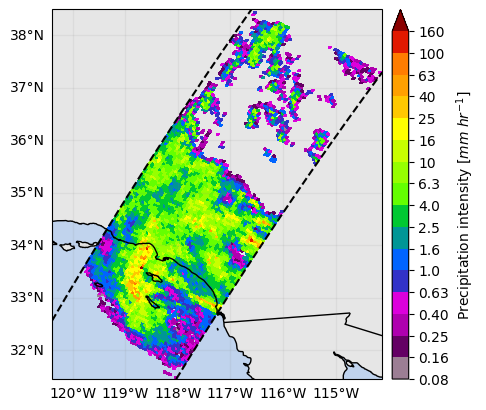

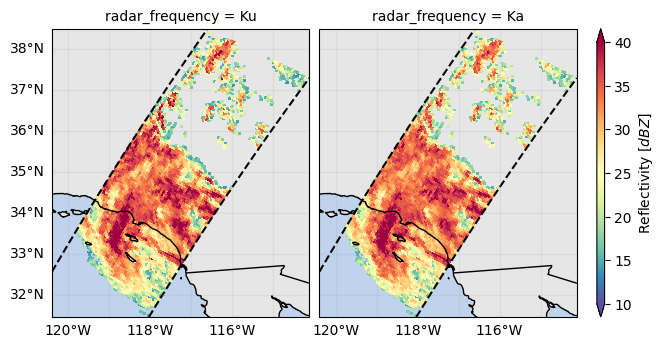

In [ ]:
# Display GPM overpass
ds_sr["precipRateNearSurface"].gpm.plot_map()
ds_sr["zFactorFinalNearSurface"].gpm.plot_map(vmax=40, col="radar_frequency")

During this tutorial we will use only the GPM DPR Ku band reflectivities, therefore we subset the dataset here to facilitate the analysis.

Please note that the GPM DPR reflectivites measurements are provided by the `ZFactorFinal`and `ZFactorMeasured` variables. 
- The `ZFactorMeasured` variable contains the reflectivity measurements with sidelobe clutter removed. However, it still includes ground clutter, background noise, and is not corrected for atmospheric and hydrometeors attenuation.
- The `ZFactorFinal` represents the reflectivity measurements with background noise, ground clutter, and sidelobe clutter removed. The reflectivites have been corrected atmospheric and hydrometeors attenuation.


In [ ]:
ds_sr = ds_sr.sel({"radar_frequency": "Ku"})

In [ ]:
display(ds_sr)

<xarray.Dataset> Size: 83MB
Dimensions:                       (cross_track: 49, along_track: 151,
                                   nfreqHI: 3, range: 176, nNode: 5,
                                   nbinSZP: 7, nNUBF: 3, method: 6, three: 3,
                                   foreBack: 2, nearFar: 2, nsdew: 3, four: 4,
                                   nNP: 4, XYZ: 3, DSD_params: 2)
Coordinates: (12/16)
    sunLocalTime                  (cross_track, along_track) float32 30kB 14....
    height                        (cross_track, along_track, range) float32 5MB ...
    dataQuality                   (along_track) float32 604B 0.0 0.0 ... 0.0 0.0
    SCorientation                 (along_track) float32 604B 0.0 0.0 ... 0.0 0.0
    lon                           (cross_track, along_track) float32 30kB -12...
    lat                           (cross_track, along_track) float32 30kB 32....
    ...                            ...
    gpm_along_track_id            (along_track) int64 1kB 2768 2769 ... 2918
  * range                         (range) int64 1kB 1 2 3 4 ... 173 174 175 176
    gpm_range_id                  (range) int64 1kB 0 1 2 3 ... 172 173 174 175
    radar_frequency               <U2 8B 'Ku'
  * DSD_params                    (DSD_params) <U2 16B 'Nw' 'Dm'
    crsWGS84                      int64 8B 0
Dimensions without coordinates: cross_track, along_track, nfreqHI, nNode,
                                nbinSZP, nNUBF, method, three, foreBack,
                                nearFar, nsdew, four, nNP, XYZ
Data variables: (12/139)
    flagBB                        (cross_track, along_track) float64 59kB nan...
    binBBPeak                     (cross_track, along_track) float32 30kB nan...
    binBBTop                      (cross_track, along_track) float32 30kB nan...
    binDFRmMLBottom               (cross_track, along_track) float32 30kB nan...
    binDFRmMLTop                  (cross_track, along_track) float32 30kB nan...
    binBBBottom                   (cross_track, along_track) float32 30kB nan...
    ...                            ...
    precipWaterIntegrated_Liquid  (cross_track, along_track) float32 30kB 0.0...
    precipWaterIntegrated_Solid   (cross_track, along_track) float32 30kB 0.0...
    precipWaterIntegrated         (cross_track, along_track) float32 30kB 0.0...
    dBNw                          (cross_track, along_track, range) float32 5MB ...
    Dm                            (cross_track, along_track, range) float32 5MB ...
    Nw                            (cross_track, along_track, range) float32 5MB ...
Attributes: (12/23)
    FileName:              2A.GPM.DPR.V9-20211125.20230820-S213941-E231213.05...
    EphemerisFileName:     
    AttitudeFileName:      
    TotalQualityCode:      Good
    DielectricFactorKa:    0.8989
    DielectricFactorKu:    0.9255
    ...                    ...
    DataFormatVersion:     7h
    MetadataVersion:       7h
    ProcessingMode:        STD
    ScanMode:              FS
    history:               Created by ghiggi/gpm_api software on 2024-08-16 1...
    gpm_api_product:       2A-DPR

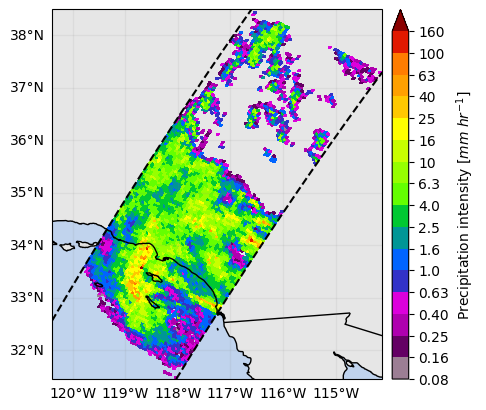

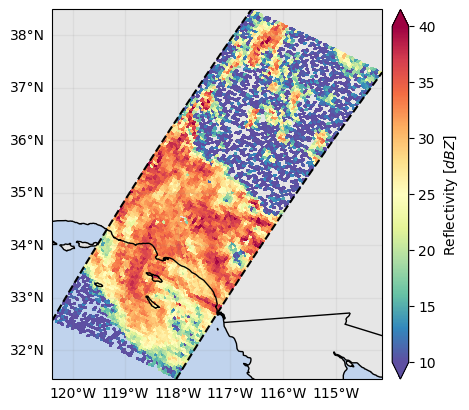

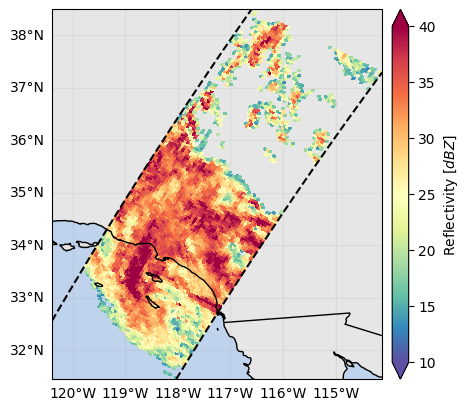

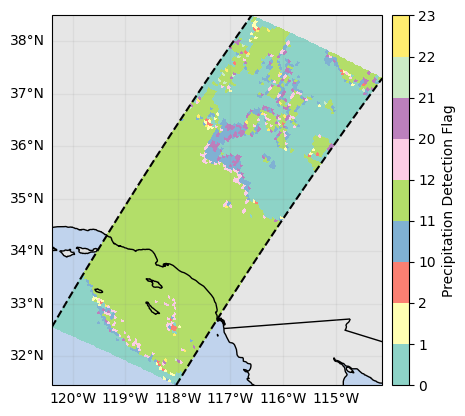

In [ ]:
# Display some variables
ds_sr["precipRateNearSurface"].gpm.plot_map()
ds_sr["zFactorMeasured"].gpm.slice_range_at_bin(ds_sr["binClutterFreeBottom"]).gpm.plot_map(
    vmax=40,
)  # zFactorMeasuredNearSurface
ds_sr["zFactorFinalNearSurface"].gpm.plot_map(vmax=40)
ds_sr["flagPrecip"].gpm.plot_map()

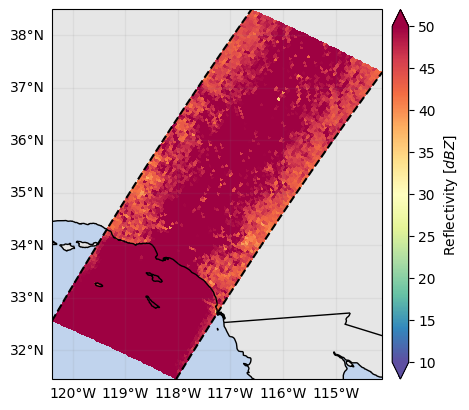

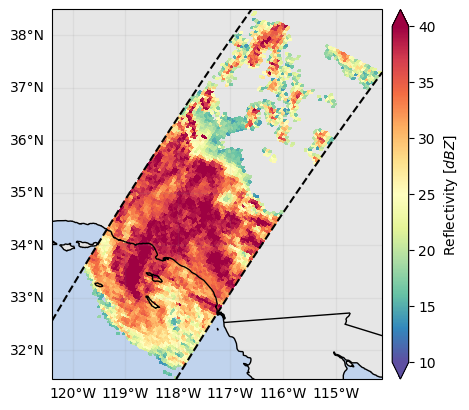

In [ ]:
ds_sr["zFactorMeasured"].max(dim="range").gpm.plot_map()
ds_sr["zFactorFinal"].max(dim="range").gpm.plot_map(vmax=40)

In [ ]:
# Compute SR attenuation correction
ds_sr["zFactorCorrection"] = ds_sr["zFactorFinal"] - ds_sr["zFactorMeasured"]

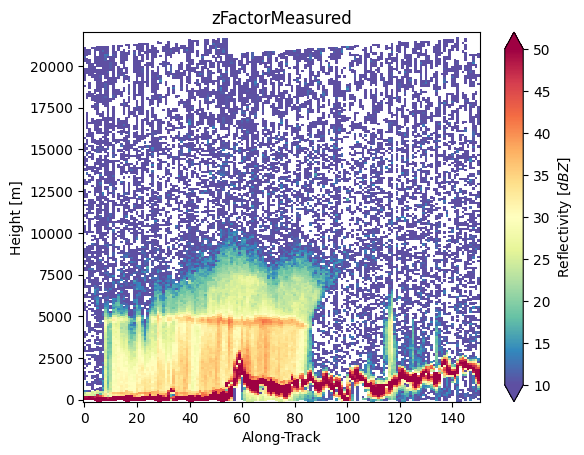

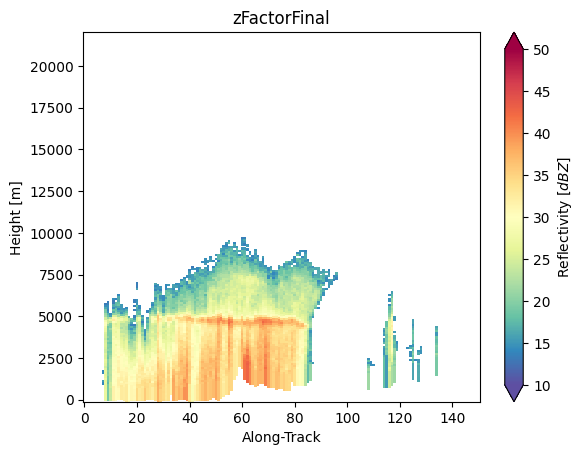

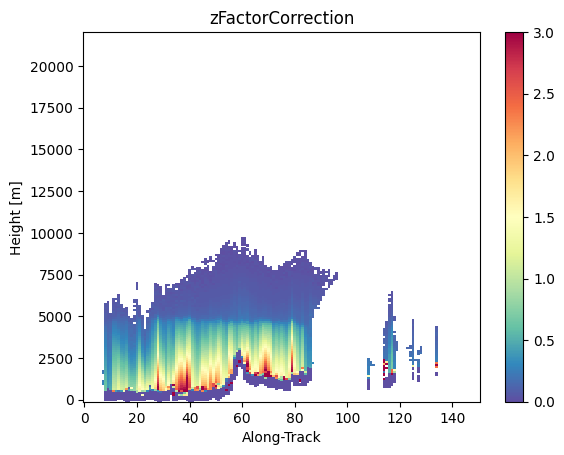

In [ ]:
# Display transect
ds_sr["zFactorMeasured"].isel(cross_track=24).gpm.plot_transect(zoom=False)
ds_sr["zFactorFinal"].isel(cross_track=24).gpm.plot_transect(zoom=False)
ds_sr["zFactorCorrection"].isel(cross_track=24).gpm.plot_transect(vmin=0, vmax=3, cmap="Spectral_r", zoom=False)

In [ ]:
# Mask SR gates with ground clutter
ds_sr["zFactorMeasured"] = ds_sr["zFactorMeasured"].gpm.mask_below_bin(
    bins=ds_sr["binClutterFreeBottom"],
    strict=False,
)  # do not mask the specified bin
ds_sr["zFactorCorrection"] = ds_sr["zFactorCorrection"].gpm.mask_below_bin(
    bins=ds_sr["binClutterFreeBottom"],
    strict=False,
)  # do not mask the specified bin

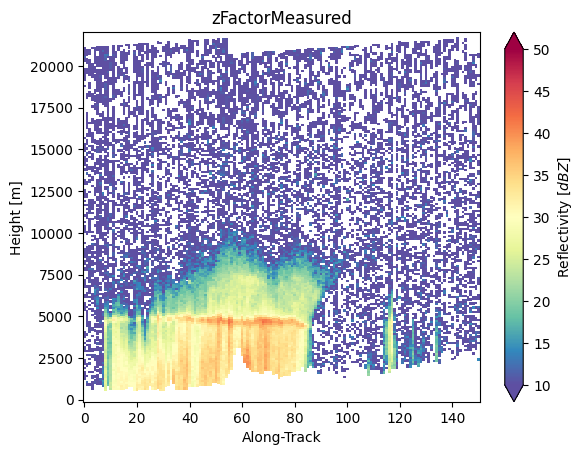

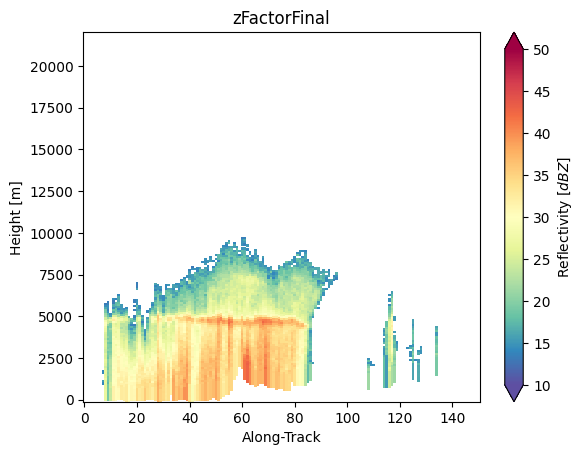

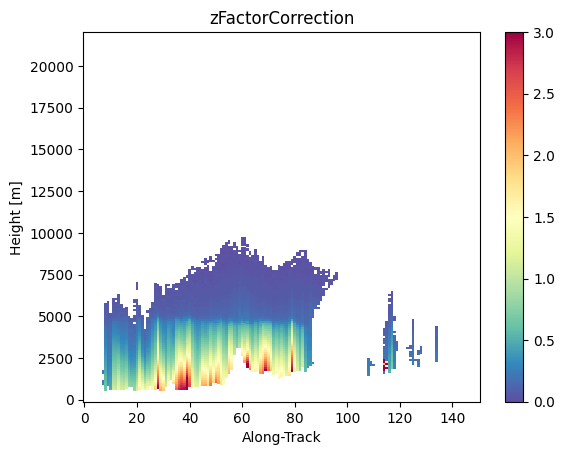

In [ ]:
# Display transect with ground clutter masked out
ds_sr["zFactorMeasured"].isel(cross_track=24).gpm.plot_transect(zoom=False)
ds_sr["zFactorFinal"].isel(cross_track=24).gpm.plot_transect(zoom=False)
ds_sr["zFactorCorrection"].isel(cross_track=24).gpm.plot_transect(vmin=0, vmax=3, cmap="Spectral_r", zoom=False)

## Load GR data with xradar

Here we read directly NEXRAD data directly from the S3 bucket.

In [ ]:
filepath = "noaa-nexrad-level2/2023/08/20/KNKX/KNKX20230820_220808_V06"
# filepath = 'noaa-nexrad-level2/2023/08/20/KNKX/KNKX20230820_221341_V06'

file = fsspec.open_local(
    f"simplecache::s3://{filepath}",
    s3={"anon": True},
    filecache={"cache_storage": "."},
)
dt_gr = xd.io.open_nexradlevel2_datatree(file)
display(dt_gr)

DataTree('root', parent=None)
│   Dimensions:              ()
│   Data variables:
│       volume_number        int64 8B 0
│       platform_type        <U5 20B 'fixed'
│       instrument_type      <U5 20B 'radar'
│       time_coverage_start  <U20 80B '2023-08-20T22:08:08Z'
│       time_coverage_end    <U20 80B '2023-08-20T22:13:33Z'
│       longitude            float64 8B -117.0
│       altitude             int64 8B 320
│       latitude             float64 8B 32.92
│   Attributes:
│       Conventions:      None
│       instrument_name:  KNKX
│       version:          None
│       title:            None
│       institution:      None
│       references:       None
│       source:           None
│       history:          None
│       comment:          im/exported using xradar
├── DataTree('sweep_0')
│       Dimensions:            (azimuth: 720, range: 1832)
│       Coordinates:
│           elevation          (azimuth) float64 6kB ...
│           time               (azimuth) datetime64[ns] 6kB 2023-08-20T22:08:19.42800...
│         * range              (range) float32 7kB 2.125e+03 2.375e+03 ... 4.599e+05
│           longitude          float64 8B ...
│           latitude           float64 8B ...
│           altitude           int64 8B ...
│         * azimuth            (azimuth) float64 6kB 0.2527 0.7526 1.263 ... 359.3 359.7
│       Data variables:
│           DBZH               (azimuth, range) float64 11MB ...
│           ZDR                (azimuth, range) float64 11MB ...
│           PHIDP              (azimuth, range) float64 11MB ...
│           RHOHV              (azimuth, range) float64 11MB ...
│           CCORH              (azimuth, range) float64 11MB ...
│           sweep_mode         <U20 80B ...
│           sweep_number       int64 8B ...
│           prt_mode           <U7 28B ...
│           follow_mode        <U7 28B ...
│           sweep_fixed_angle  float64 8B ...
│       Attributes:
│           instrument_name:  KNKX
├── DataTree('sweep_1')
│       Dimensions:            (azimuth: 720, range: 1192)
│       Coordinates:
│           elevation          (azimuth) float64 6kB ...
│           time               (azimuth) datetime64[ns] 6kB 2023-08-20T22:08:37.17299...
│         * range              (range) float32 5kB 2.125e+03 2.375e+03 ... 2.999e+05
│           longitude          float64 8B ...
│           latitude           float64 8B ...
│           altitude           int64 8B ...
│         * azimuth            (azimuth) float64 6kB 0.2005 0.7141 1.211 ... 359.2 359.7
│       Data variables:
│           DBZH               (azimuth, range) float64 7MB ...
│           VRADH              (azimuth, range) float64 7MB ...
│           WRADH              (azimuth, range) float64 7MB ...
│           sweep_mode         <U20 80B ...
│           sweep_number       int64 8B ...
│           prt_mode           <U7 28B ...
│           follow_mode        <U7 28B ...
│           sweep_fixed_angle  float64 8B ...
│       Attributes:
│           instrument_name:  KNKX
├── DataTree('sweep_2')
│       Dimensions:            (azimuth: 720, range: 1192)
│       Coordinates:
│           elevation          (azimuth) float64 6kB ...
│           time               (azimuth) datetime64[ns] 6kB 2023-08-20T22:08:57.72499...
│         * range              (range) float32 5kB 2.125e+03 2.375e+03 ... 2.999e+05
│           longitude          float64 8B ...
│           latitude           float64 8B ...
│           altitude           int64 8B ...
│         * azimuth            (azimuth) float64 6kB 0.2087 0.7141 1.208 ... 359.2 359.7
│       Data variables:
│           DBZH               (azimuth, range) float64 7MB ...
│           VRADH              (azimuth, range) float64 7MB ...
│           WRADH              (azimuth, range) float64 7MB ...
│           sweep_mode         <U20 80B ...
│           sweep_number       int64 8B ...
│           prt_mode           <U7 28B ...
│           follow_mode        <U7 28B ...
│           sweep_fixed_angle  

Here, we define key parameters and settings necessary for the SR/GR comparison. Minimum reflectivity thresholds are applied to exclude certain radar gates from the analysis, primarily to distinguish precipitating regions. We strongly recommend specifying an "optimistic" minimum reflectivity sensitivity threshold, as reflectivities may be biased, and this approach allows for the assessment of non-uniform beam filling (NUBF) during the SR/GR matching process. More restrictive filtering can be applied after the SR/GR gate matching is completed.

In [ ]:
# Define half power beam width angle (in degrees)
azimuth_beamwidth_gr = 1.0
elevation_beamwidth_gr = 1.0

# Define Z min threshold
z_min_threshold_gr = 0  # to remove dry case
z_min_threshold_sr = 10

# GR matching ROI
min_gr_range_lb = 0
max_gr_range_ub = 150_000

# Define SR CRS
crs_sr = ds_sr.gpm.pyproj_crs

Now we select the GR sweep, we set the GR CRS and we extract GR radar gates coordinates.

In [ ]:
sweep_idx = 0
sweep_group = f"sweep_{sweep_idx}"  # GR sweep (elevation to be used)

In [ ]:
# Select sweep dataset
ds_gr = dt_gr[sweep_group].ds
ds_gr["sweep_mode"].values
ds_gr["sweep_fixed_angle"].values

# Set auxiliary info as coordinates
# - To avoid broadcasting i.e. when masking
possible_coords = ["sweep_mode", "sweep_number", "prt_mode", "follow_mode", "sweep_fixed_angle"]
extra_coords = [coord for coord in possible_coords if coord in ds_gr]
ds_gr = ds_gr.set_coords(extra_coords)

In [ ]:
# Georeference the data on a azimuthal_equidistant projection centered on the radar
ds_gr = ds_gr.xradar.georeference()
ds_gr["crs_wkt"].attrs

{'crs_wkt': 'PROJCRS["unknown",BASEGEOGCRS["unknown",DATUM["World Geodetic System 1984",ELLIPSOID["WGS 84",6378137,298.257223563,LENGTHUNIT["metre",1]],ID["EPSG",6326]],PRIMEM["Greenwich",0,ANGLEUNIT["degree",0.0174532925199433],ID["EPSG",8901]]],CONVERSION["unknown",METHOD["Modified Azimuthal Equidistant",ID["EPSG",9832]],PARAMETER["Latitude of natural origin",32.919017791748,ANGLEUNIT["degree",0.0174532925199433],ID["EPSG",8801]],PARAMETER["Longitude of natural origin",-117.041801452637,ANGLEUNIT["degree",0.0174532925199433],ID["EPSG",8802]],PARAMETER["False easting",0,LENGTHUNIT["metre",1],ID["EPSG",8806]],PARAMETER["False northing",0,LENGTHUNIT["metre",1],ID["EPSG",8807]]],CS[Cartesian,2],AXIS["(E)",east,ORDER[1],LENGTHUNIT["metre",1,ID["EPSG",9001]]],AXIS["(N)",north,ORDER[2],LENGTHUNIT["metre",1,ID["EPSG",9001]]]]',
 'semi_major_axis': 6378137.0,
 'semi_minor_axis': 6356752.314245179,
 'inverse_flattening': 298.257223563,
 'reference_ellipsoid_name': 'WGS 84',
 'longitude_of_prim

In [ ]:
# Get the GR CRS
crs_gr = ds_gr.xradar_dev.pyproj_crs

In [ ]:
# Add lon/lat coordinates to GR
# - Useful for plotting ;)
lon_gr, lat_gr, height_gr = reproject_coords(x=ds_gr["x"], y=ds_gr["y"], z=ds_gr["z"], src_crs=crs_gr, dst_crs=crs_sr)
ds_gr["lon"] = lon_gr
ds_gr["lat"] = lat_gr
ds_gr = ds_gr.set_coords(["lon", "lat"])

In [ ]:
# Set GR gates with Z < 0 to NaN
# - Following Morris and Schwaller 2011 recommendation
ds_gr = ds_gr.where(ds_gr["DBZH"] >= 0)

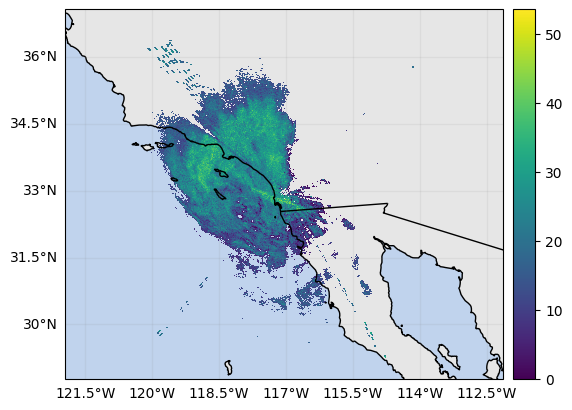

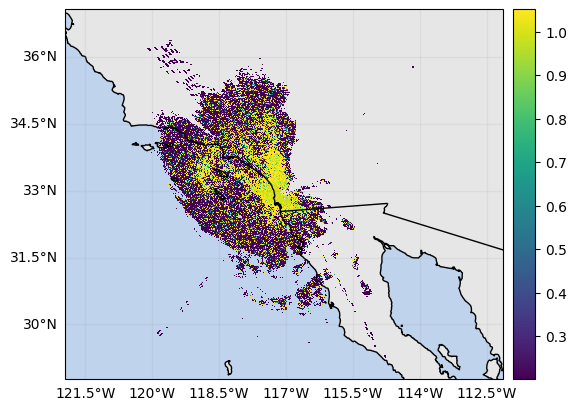

In [ ]:
# Show some GR fields
ds_gr["DBZH"].xradar_dev.plot_map()
ds_gr["RHOHV"].xradar_dev.plot_map()

In [ ]:
# Retrieve GR extent
extent_gr = ds_gr.xradar_dev.extent(max_distance=None, crs=None)
extent_gr

[-121.95467110437517,
 -112.12893180089884,
 28.771031109975677,
 37.06425438465268]

## Retrieve GR gate resolution

In this subsection we derive the horizontal and vertical resolution of GR gates. 

The GR horizontal and vertical resolution change as a function of the range distance.


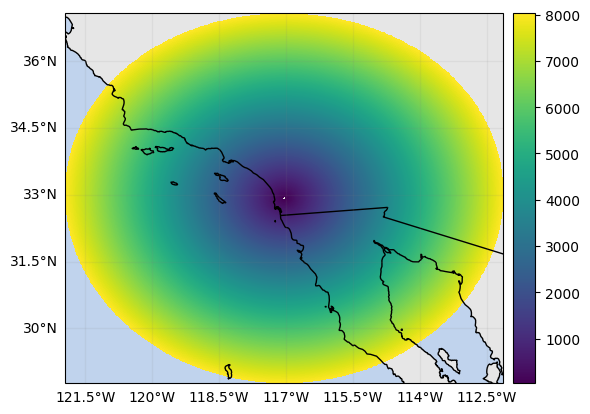

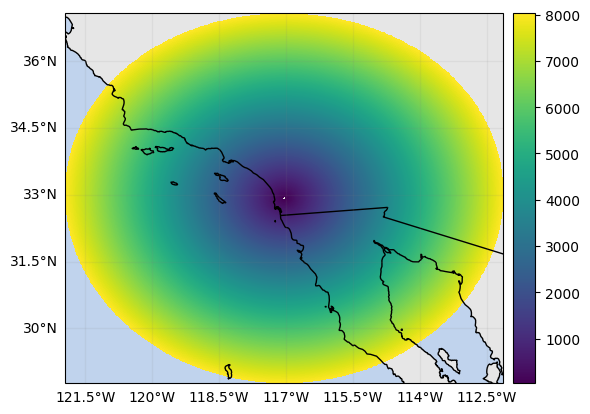

In [ ]:
# Compute horizontal and vertical GR gate resolution
h_res_gr, v_res_gr = ds_gr.xradar_dev.resolution_at_range(
    azimuth_beamwidth=azimuth_beamwidth_gr,
    elevation_beamwidth=elevation_beamwidth_gr,
)
h_res_gr.xradar_dev.plot_map()
v_res_gr.xradar_dev.plot_map()

## Define GR range distance interval

Now let's define the minimum range distance at which the GR gate vertical resolution is larger than 150/250 m (the range resolution of GPM) and at which GR distance the GR gate vertical resolution exceed 1500 m (which correspond to 12/6 SR gates included in a GR gate)

Minimum GR distance: 14125.0 m
Maximum GR distance: 85875.0 m


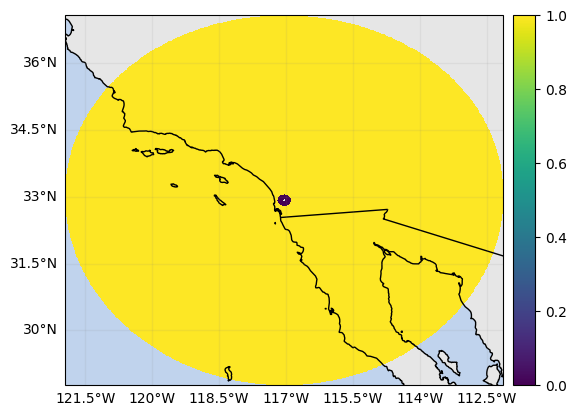

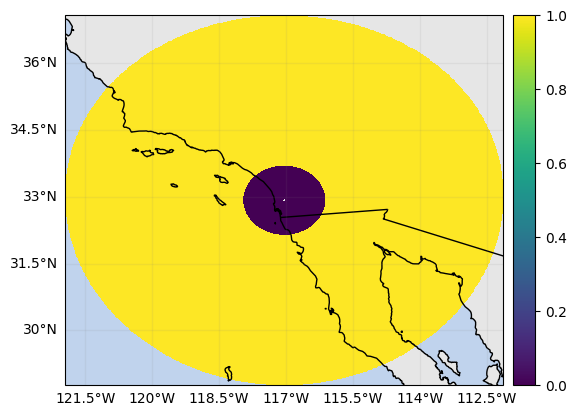

In [ ]:
mask_gr_gate_depth_above_250 = v_res_gr > 250
mask_gr_gate_depth_above_250.xradar_dev.plot_map()
min_gr_range = np.max(
    mask_gr_gate_depth_above_250["range"].data[mask_gr_gate_depth_above_250.sum(dim="azimuth") == 0],
)  # min_range_distance

mask_gr_gate_depth_below_2000 = v_res_gr > 1500
mask_gr_gate_depth_below_2000.xradar_dev.plot_map()
max_gr_range = np.max(
    mask_gr_gate_depth_below_2000["range"].data[mask_gr_gate_depth_below_2000.sum(dim="azimuth") == 0],
)  # min_range_distance

print("Minimum GR distance:", min_gr_range, "m")
print("Maximum GR distance:", max_gr_range, "m")

Now let's specify the minimum and maximum GR range distance to consider when matching SR/GR gates.

It's good practice to avoid restricting too much at this stage. Matched SR/GR gates can be filtered afterwards.

In [ ]:
# Specify GR range distance interval over which to perform SR matching
min_gr_range = min_gr_range  # about 15_000 km
max_gr_range = 150_000

## Display SR slice and GR sweep

In [ ]:
# Slice SR volume
da_sr = ds_sr["zFactorFinal"].isel(range=-5)
da_sr = ds_sr["zFactorFinal"].gpm.slice_range_at_bin(ds_sr["binClutterFreeBottom"])
da_sr = ds_sr["zFactorFinal"].gpm.slice_range_at_height(value=2000)

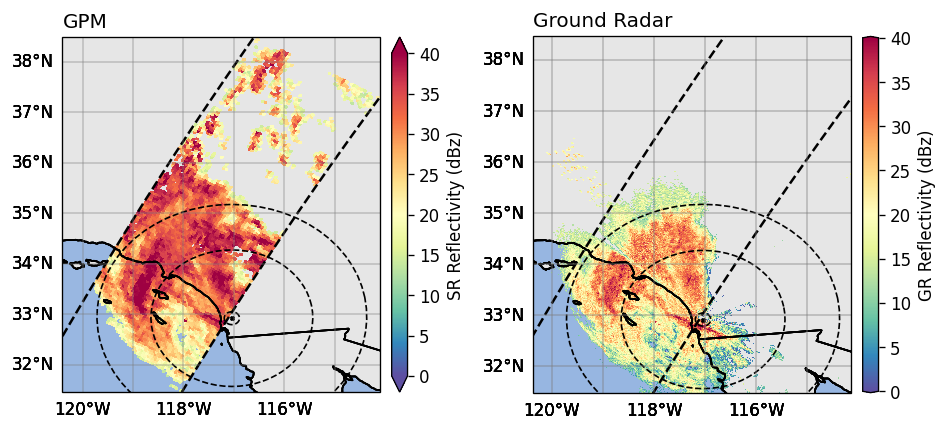

In [ ]:
# Define SR and GR mask
mask_gr = ds_gr["DBZH"] >= z_min_threshold_gr
# mask_gr = np.logical_and(ds_gr["DBZH"] >= z_min_threshold_gr, ds_gr["RHOHV"] >= 0.80)

mask_sr = True  # aka do not mask

# Retrieve SR extent
sr_extent = ds_sr.gpm.extent()

# Define cmap
cmap = "Spectral_r"

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4), dpi=120, subplot_kw={"projection": ccrs.PlateCarree()})
# - Plot SR
p_sr = da_sr.where(mask_sr).gpm.plot_map(
    ax=ax1,
    cmap=cmap,
    vmin=0,
    vmax=40,
    cbar_kwargs={"label": "SR Reflectivity (dBz)"},
    add_colorbar=True,
)
# - Plot GR
ds_gr["DBZH"].where(mask_gr).xradar_dev.plot_map(
    ax=ax2,
    cmap=cmap,
    vmin=0,
    vmax=40,
    cbar_kwargs={"label": "GR Reflectivity (dBz)", "extend": "both"},
    add_colorbar=True,
)
# - Add the SR swath boundary
da_sr.gpm.plot_swath_lines(ax=ax2)
# - Restrict the extent to the SR overpass
ax2.set_extent(sr_extent)
# - Display GR range distances
for ax in [ax1, ax2]:
    ds_gr.xradar_dev.plot_range_distance(
        distance=min_gr_range,
        ax=ax,
        add_background=True,
        linestyle="dashed",
        edgecolor="black",
    )
    ds_gr.xradar_dev.plot_range_distance(
        distance=max_gr_range,
        ax=ax,
        add_background=True,
        linestyle="dashed",
        edgecolor="black",
    )
    ds_gr.xradar_dev.plot_range_distance(
        distance=250_000,
        ax=ax,
        add_background=True,
        linestyle="dashed",
        edgecolor="black",
    )
# - Add GR location
ax1.scatter(ds_gr["longitude"], ds_gr["latitude"], c="black", marker="X", s=4)
ax2.scatter(ds_gr["longitude"], ds_gr["latitude"], c="black", marker="X", s=4)
# - Set title
ax1.set_title("GPM", fontsize=12, loc="left")
ax2.set_title("Ground Radar", fontsize=12, loc="left")
# - Improve layout and display
plt.tight_layout()
plt.show()

## Retrieve GR (lon, lat) coordinates
Here we retrieve the 2D non-dimensional longitude and latitude coordinates in the CRS of the SR.
These 2D coordinates will have dimensions (azimuth, range) 

In [ ]:
lon_gr, lat_gr, height_gr = reproject_coords(x=ds_gr["x"], y=ds_gr["y"], z=ds_gr["z"], src_crs=crs_gr, dst_crs=crs_sr)

# If crs_gr and crs_sr share same datum/ellispoid, z does not vary
print(crs_gr.datum)
print(crs_sr.datum)

World Geodetic System 1984
Unknown based on WGS 84 ellipsoid


## Retrieve SR (x,y,z) coordinates

Here we retrieve the 3D (x,y,z) coordinates of SR gates in the GR CRS projection. 

The GR CRS is a azimuthal equidistant (AZEQ) projection centered on the ground radar. 
In the GR CRS, the (x,y) coordinates (0,0) corresponds to the location of the ground radar.
Therefore, the retrieved SR (x,y) coordinates are relative to the ground radar site, while the z coordinates is relative to the ellipsoid.

In [ ]:
x_sr, y_sr, z_sr = retrieve_gates_projection_coordinates(ds_sr, dst_crs=crs_gr)

## Retrieve SR (range, azimuth, elevation) coordinates

Now we inverse the SR (x,y,z) 3D GR CRS coordinates to derive the SR (range, azimuth, elevation) coordinates with respect to GR sweep.
These coordinates allow to identify the SR gates intersecting the GR sweep.

In [ ]:
range_sr, azimuth_sr, elevation_sr = xyz_to_antenna_coordinates(
    x=x_sr,
    y=y_sr,
    z=z_sr,
    site_altitude=ds_gr["altitude"],
    crs=crs_gr,
    effective_radius_fraction=None,
)
print(range_sr.isel(cross_track=0).min().item(), "m")  # far from the radar
print(range_sr.isel(cross_track=-1).min().item(), "m")  # closer to radar

252837.9704755049 m
9164.066906023296 m


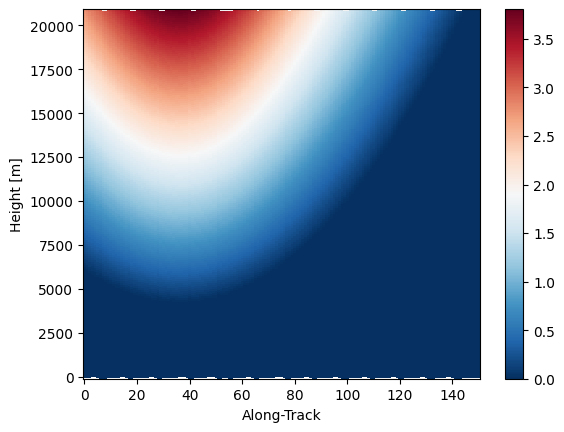

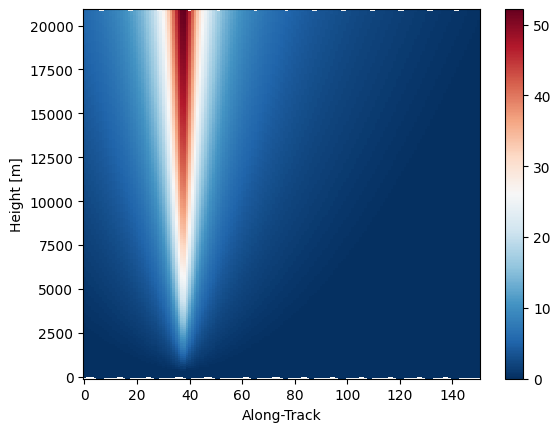

In [ ]:
# Show elevation angle at different SR scan angle
elevation_sr.isel(cross_track=0).gpm.plot_transect(vmin=0)  # far from the radar
elevation_sr.isel(cross_track=-1).gpm.plot_transect(vmin=0)  # closer to radar

## Retrieve SR range distance 
Here we retrieve the range distance from the satellite for each SR radar gate. 
We can accurately retrieve it from the GPM L1B product using the following code:


In [ ]:
# Retrieve L1B accurate range distance
ds_l1b_sr["range_distance_from_satellite"] = ds_l1b_sr.gpm.retrieve("range_distance_from_satellite")
ds_sr["range_distance_from_satellite"] = ds_l1b_sr.gpm.extract_l2_dataset()["range_distance_from_satellite"]

The `range_distance_from_satellite` can also be derived from the GPM L2 product if we assume a cross-track scan angle. 
However, uncertainties in cross-tracks scan angle can erroneously impacts the estimates. 
As we show here below, an uncertainty of 0.1° translates to a range distance difference of up to 400 m which corresponds to 3/4 radar gates ! 









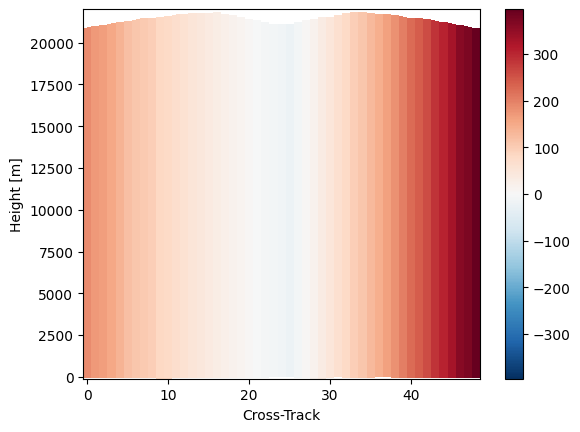

In [ ]:
# Show impact of scan angle on range distance
# - Variation of 0.01 impacts range distance up to 30 m
# - Variation of 0.05 impacts range distance up to 100 m
# - Variation of 0.1 impacts range distance up to 400 m
scan_angle_template = np.abs(np.linspace(-17.04, 17.04, 49))  # assuming Ku swath of size 49
scan_angle = xr.DataArray(scan_angle_template[ds_sr["gpm_cross_track_id"].data], dims="cross_track")
scan_angle = scan_angle + 0.1
l2_distance = ds_sr.gpm.retrieve("range_distance_from_satellite", scan_angle=scan_angle)

diff = l2_distance - ds_sr["range_distance_from_satellite"]
diff.isel(along_track=0).gpm.plot_transect()  # difference > 500 m

## Retrieve radar gates volumes

Here we compute SR and GR gate volumes.

An accurate beam width is necessary to derive accurate gate volume estimates. This is demonstrated here below !

In [ ]:
# Compute GR gates volumes
vol_gr = wrl.qual.pulse_volume(
    ds_gr["range"],  # range distance
    h=ds_gr["range"].diff("range").median(),  # range resolution
    theta=elevation_beamwidth_gr,
)  # beam width
vol_gr = vol_gr.broadcast_like(ds_gr["DBZH"])
vol_gr = vol_gr.assign_coords({"lon": ds_gr["lon"], "lat": ds_gr["lat"]})

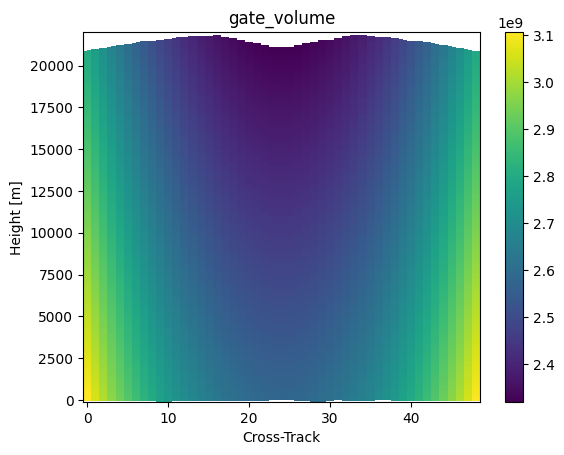

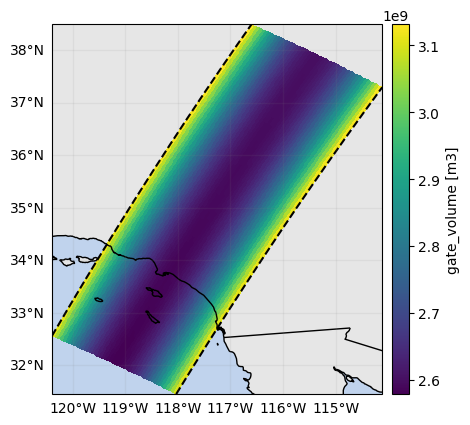

In [ ]:
# Compute SR gates volumes
range_distance = ds_sr["range_distance_from_satellite"]
vol_sr = ds_sr.gpm.retrieve("gate_volume", beam_width=beam_width_sr, range_distance=range_distance)
vol_sr.isel(along_track=0).gpm.plot_transect()
vol_sr.isel(range=-1).gpm.plot_map()

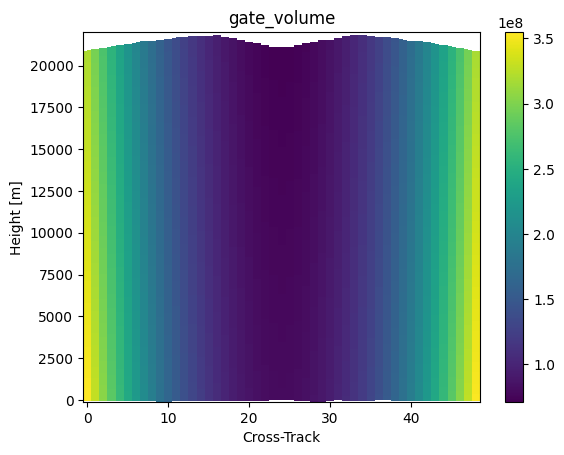

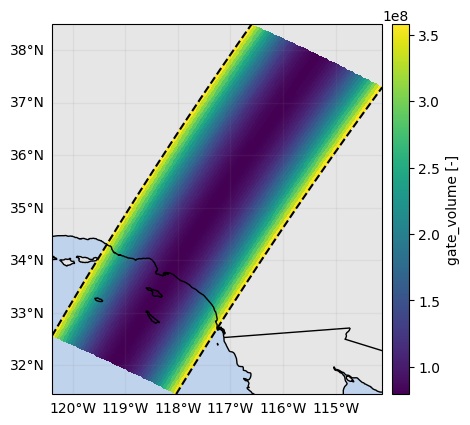

In [ ]:
# Assuming fixed beamwidth with SR leads to volume difference up to 0.35 km3
vol_sr1 = ds_sr.gpm.retrieve("gate_volume", beam_width=0.71, range_distance=range_distance)
diff = vol_sr - vol_sr1
diff.isel(along_track=0).gpm.plot_transect()
diff.isel(range=-1).gpm.plot_map()

## Retrieve SR gate resolution

In this subsection we derive the horizontal and vertical SR gate resolution.

The SR horizontal resolution change for each radar gate, while the vertical resolution varies only across SR footprints.
Note that the vertical resolution here derived is equivalent to the GPM L2 product variable `height`.

Assuming a fixed beamwidth of 0.71 can leads to variations in horizontal resolution estimates up to 400 m on the outer-track.

In [ ]:
# Compute horizontal and vertical SR gate resolution
range_distance = ds_sr["range_distance_from_satellite"]
h_res_sr, v_res_sr = ds_sr.gpm.retrieve("gate_resolution", beam_width=beam_width_sr, range_distance=range_distance)
h_radius = h_res_sr / 2

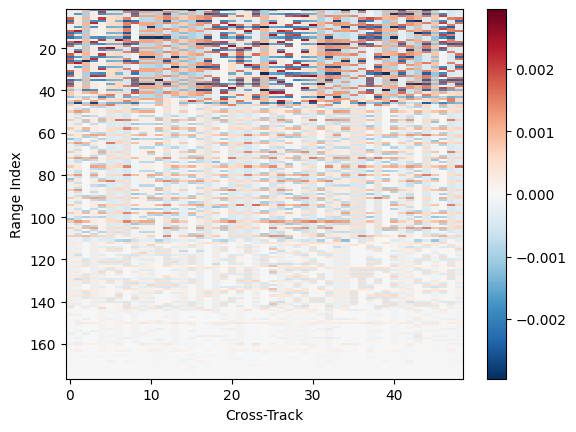

In [ ]:
# Validate v_res_sr [OK !]
diff = -ds_sr["height"].diff(dim="range") - v_res_sr
diff.isel(along_track=0).gpm.plot_transect(y="range")
plt.show()

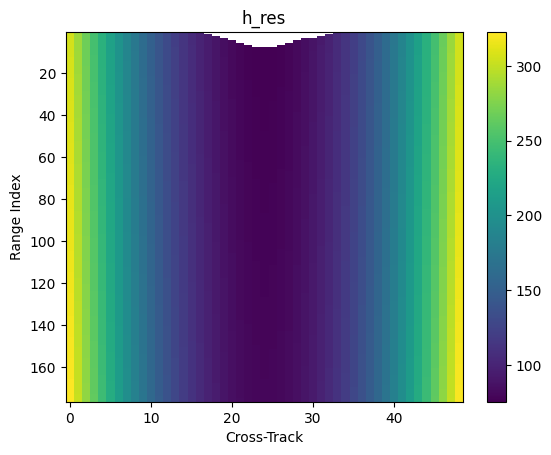

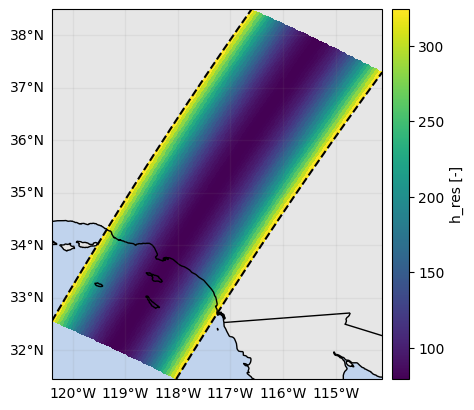

In [ ]:
# Validate h_res [PROBLEMATIC WITH FIXED BEAM WIDTH]
h_res1_sr, _ = ds_sr.gpm.retrieve("gate_resolution", beam_width=None, range_distance=range_distance)  # Use 0.71
diff = h_res_sr - h_res1_sr
diff.isel(along_track=0).gpm.plot_transect(y="range")
diff.isel(range=-1).gpm.plot_map()

## Retrieve Bright Band (BB) Ratio

Here we derive the bright band ratio, which is defined as follow:
- A BB ratio of < 0 indicates that a bin is located below the melting layer (ML).
- A BB ratio of > 0 indicates that a bin is located above the ML.
- A BB ratio with values in between 0 and 1 indicates tha the radar is inside the ML.

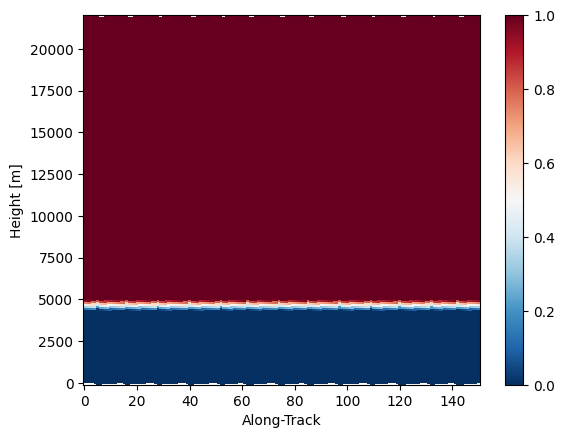

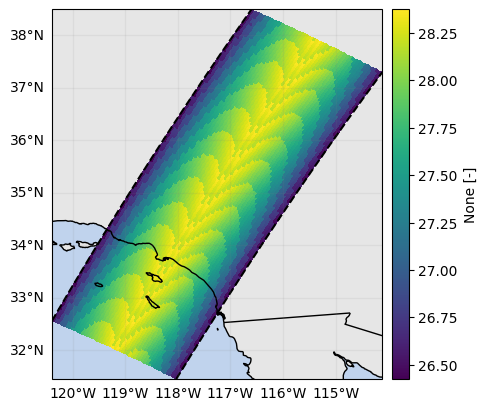

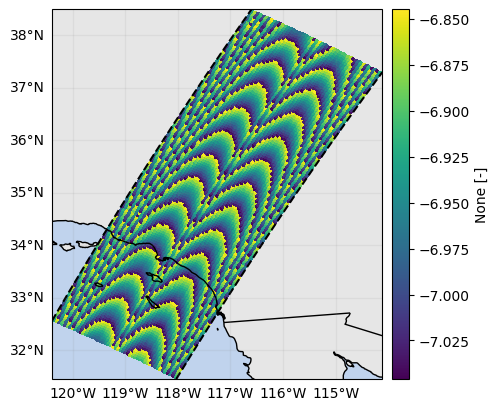

In [ ]:
da_bb_ratio, da_bb_mask = ds_sr.gpm.retrieve("bright_band_ratio", return_bb_mask=True)
da_bb_ratio.isel(cross_track=24).gpm.plot_transect(vmin=0, vmax=1)
da_bb_ratio.isel(range=0).gpm.plot_map()  # top
da_bb_ratio.isel(range=-1).gpm.plot_map()  # bottom

{'gpm_api_product': '2A-DPR',
 'flag_values': [0, 1],
 'flag_meanings': ['BB not detected', 'BB detected'],
 'description': 'Quality of Bright-Band Detection',
 'gpm_api_decoded': 'yes',
 'grid_mapping': 'crsWGS84'}

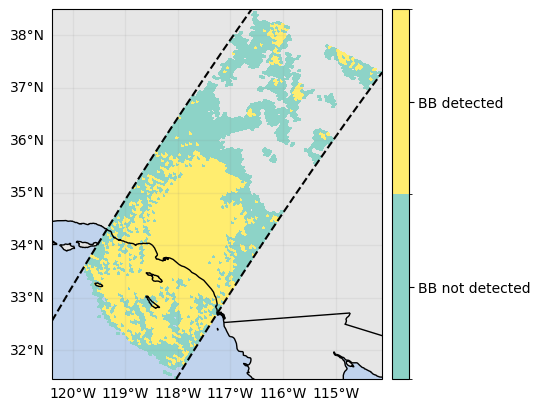

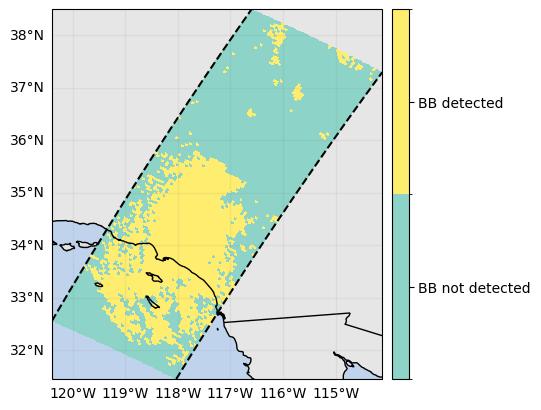

In [ ]:
# Show difference between L2 qualityBB and custom derived BB mask
ds_sr["qualityBB"].gpm.plot_map()
da_bb_mask.gpm.plot_map()
ds_sr["qualityBB"].attrs

## Retrieve Precipitation and Hydrometeors Types

{'flag_values': [0, 1, 2, 3],
 'flag_meanings': ['no rain', 'stratiform', 'convective', 'other'],
 'description': 'Precipitation type'}

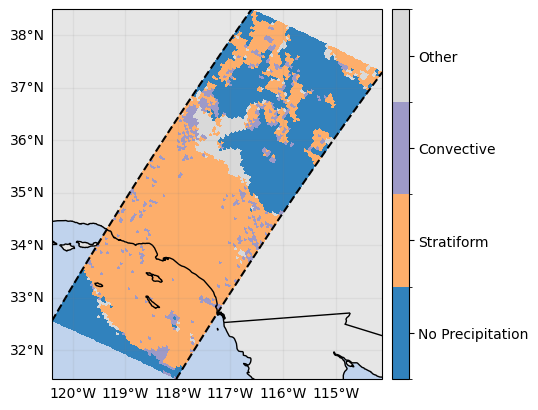

In [ ]:
# Retrieve precipitation type classification
ds_sr["flagPrecipitationType"] = ds_sr.gpm.retrieve("flagPrecipitationType", method="major_rain_type")
ds_sr["flagPrecipitationType"].gpm.plot_map()
ds_sr["flagPrecipitationType"].attrs

{'flag_values': [0, 1, 2, 3, 4, 5],
 'flag_meanings': ['no precipitation',
  'rain',
  'snow',
  'hail',
  'melting layer',
  'clutter']}

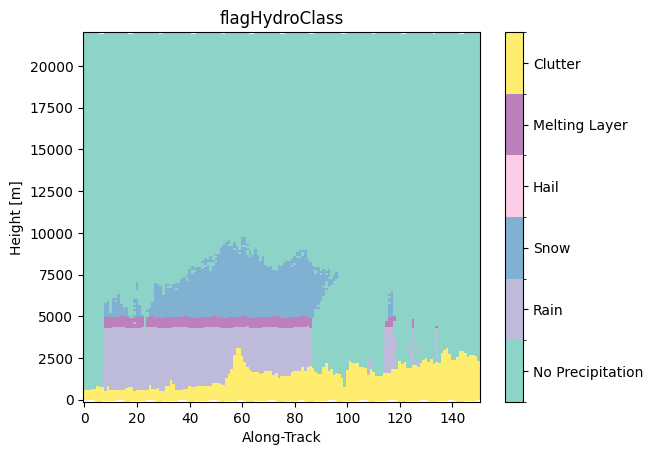

In [ ]:
# Retrieve hydrometeors classification
ds_sr["flagHydroClass"] = ds_sr.gpm.retrieve("flagHydroClass")
ds_sr["flagHydroClass"].isel(cross_track=24).gpm.plot_transect()
ds_sr["flagHydroClass"].attrs

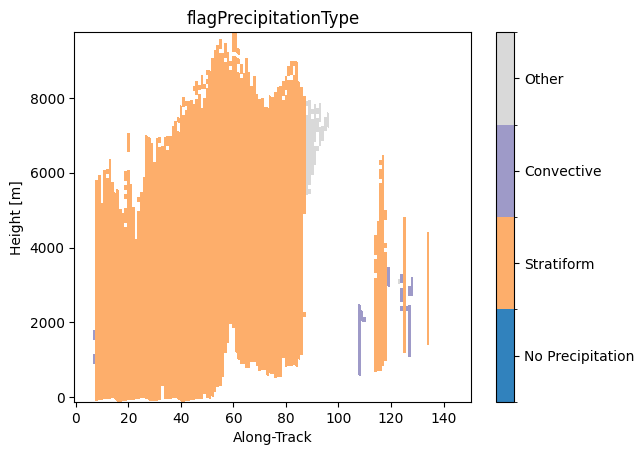

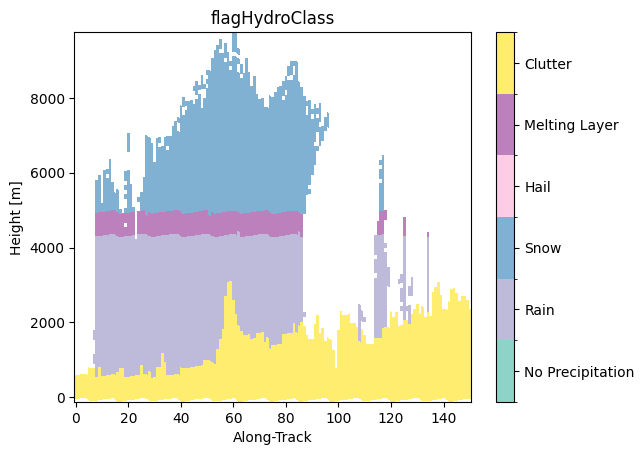

In [ ]:
# Visualize transect
precip_type3d = xr.ones_like(ds_sr["flagHydroClass"]) * ds_sr["flagPrecipitationType"]
precip_type3d = precip_type3d.where(ds_sr["zFactorFinal"] > 10)
precip_type3d.name = ds_sr["flagPrecipitationType"].name

precip_type3d.isel(cross_track=24).gpm.plot_transect()
ds_sr["flagHydroClass"].where(ds_sr["flagHydroClass"] > 0).isel(cross_track=24).gpm.plot_transect()

## Convert SR Ku-band to S-band
Here we convert reflectivities from Ku-band to S-band based on [Cao et al., (2013)](https://agupubs.onlinelibrary.wiley.com/doi/10.1002/jgrd.50138). 

When filtering the SR/GR matched samples, plase consider to select:
- only reflectivities below 35 dBZ for S-band GR radars to avoid non-rayleigh scattering
- only reflectivities below 25 dBZ for C/X-band GR radars 

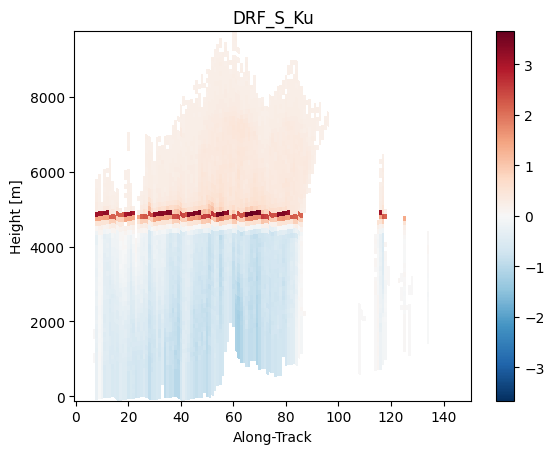

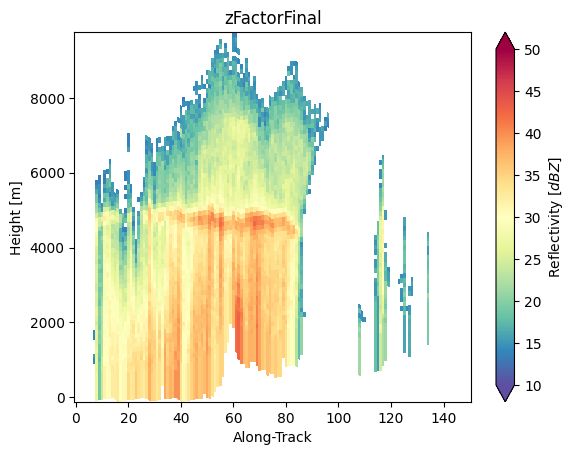

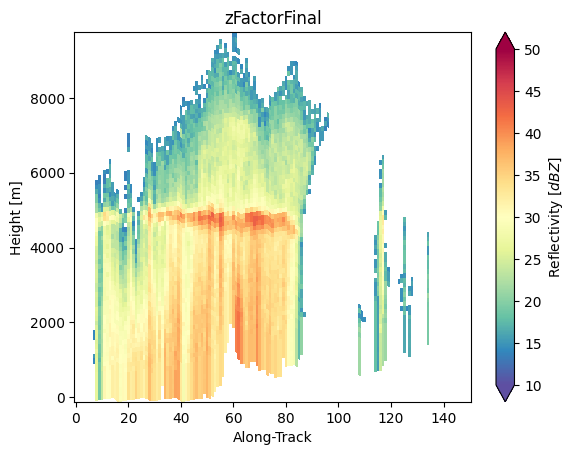

In [ ]:
# With attenuation corrected reflectivity
da_z_s_final = ds_sr.gpm.retrieve("s_band_cao2013", reflectivity="zFactorFinal", bb_ratio=None, precip_type=None)
da_z_ku_final = ds_sr["zFactorFinal"]
dfr_s_ku_final = da_z_s_final - da_z_ku_final
dfr_s_ku_final.name = "DRF_S_Ku"

dfr_s_ku_final.isel(cross_track=24).gpm.plot_transect()
da_z_ku_final.isel(cross_track=24).gpm.plot_transect()
da_z_s_final.isel(cross_track=24).gpm.plot_transect()

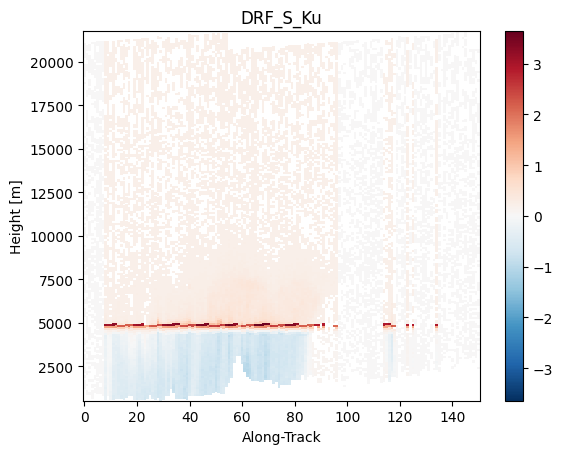

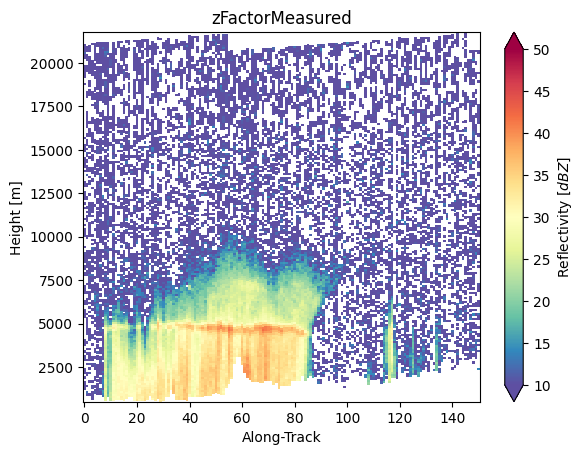

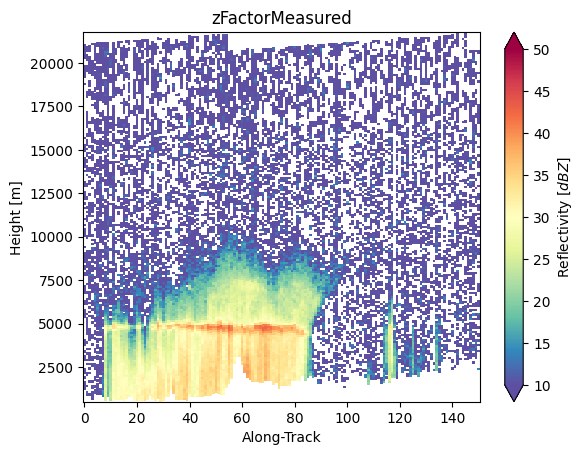

In [ ]:
# With measured reflectivity
da_z_s_measured = ds_sr.gpm.retrieve("s_band_cao2013", reflectivity="zFactorMeasured", bb_ratio=None, precip_type=None)
da_z_ku_measured = ds_sr["zFactorMeasured"]
dfr_s_ku_measured = da_z_s_measured - da_z_ku_measured
dfr_s_ku_measured.name = "DRF_S_Ku"

dfr_s_ku_measured.isel(cross_track=24).gpm.plot_transect()
da_z_ku_measured.isel(cross_track=24).gpm.plot_transect()
da_z_s_measured.isel(cross_track=24).gpm.plot_transect()

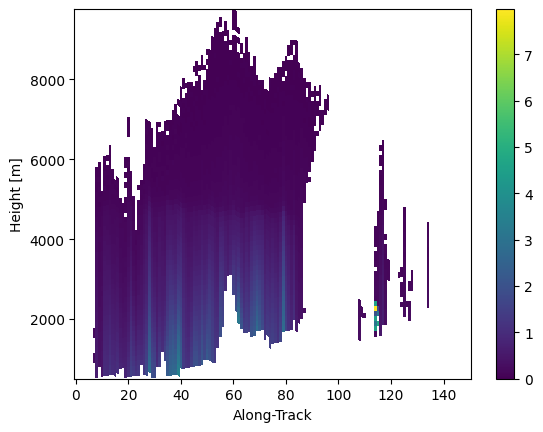

In [ ]:
# Compute attenuation correction in S-band
da_z_s_correction = da_z_s_final - da_z_s_measured
da_z_s_correction.isel(cross_track=24).gpm.plot_transect()

## Convert SR Ku-band to X and C-band

Here we convert reflectivities from Ku-band to X and C-band based on [XXX et al., (XXX)](XXX). 

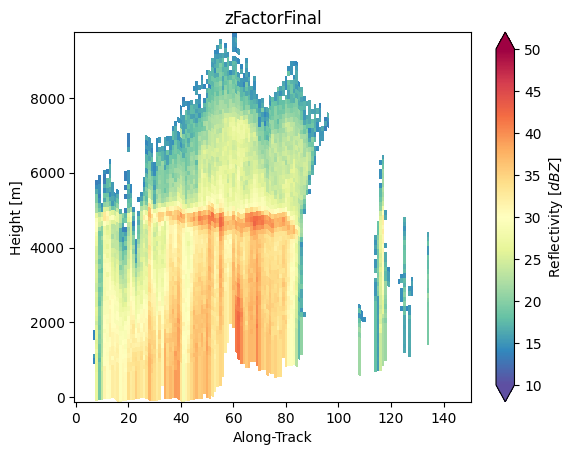

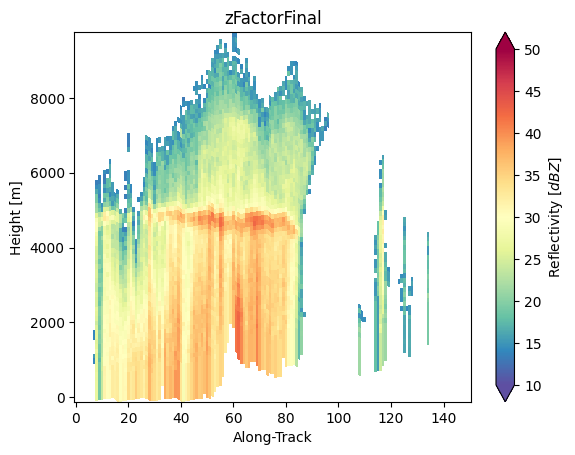

In [ ]:
da_z_c = ds_sr.gpm.retrieve("c_band_tan", bb_ratio=None, precip_type=None)
da_z_x = ds_sr.gpm.retrieve("x_band_tan", bb_ratio=None, precip_type=None)

da_z_c.isel(cross_track=24).gpm.plot_transect()
da_z_x.isel(cross_track=24).gpm.plot_transect()

## Convert GR S-band to Ku-band

Here we provide some code to convert GR S-band reflectivities to Ku-band. 

However, the resulting reflectivities are not used in the rest of the tutorial.

The methodology we adopt currently use only an average bright band height to discern between liquid and solid phase precipitation, and it does not account for mixed-phase precipitation and the phase transition. We welcome contributions to improve this portion of code ;) 

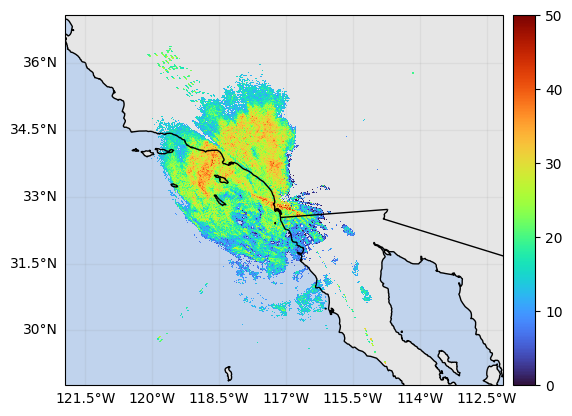

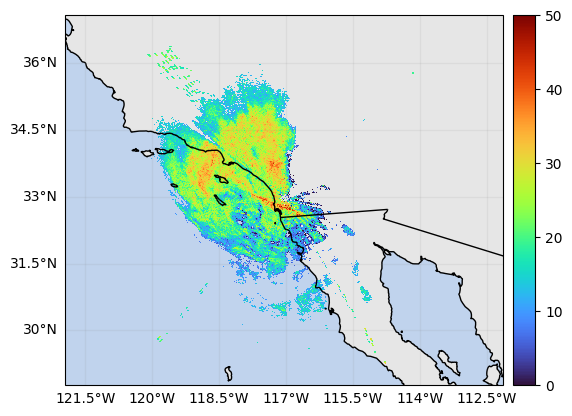

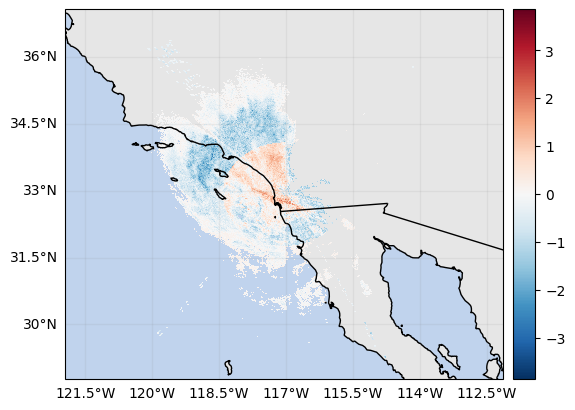

In [ ]:
# Estimate bright band height
bright_band_height = np.nanmean(ds_sr["heightBB"])
# Retrieve Ku-band reflectivities from GR S-band reflectivities
da_gr_ku = convert_s_to_ku_band(ds_gr=ds_gr, bright_band_height=bright_band_height)

da_gr_s = ds_gr["DBZH"]
da_gr_s.xradar_dev.plot_map(cmap="turbo", vmin=0, vmax=50)
plt.show()

da_gr_ku.xradar_dev.plot_map(cmap="turbo", vmin=0, vmax=50)
plt.show()

diff = da_gr_ku - da_gr_s
diff.xradar_dev.plot_map()
plt.show()

## Identify SR gates intersecting GR sweep

Here we define the mask used to select SR footprints intersecting the GR sweep gates. 
Using other terms, we can describe this task as finding SR gates that, once aggregated, "match" with the GR sweep plane-position-indicator (PPI) display.

To this end, we need to filter SR gates by GR `range` distance and `elevation` angle. 

Since the GR CRS is centered on the GR radar location, we can define the SR range mask using the "GR" `range` coordinate.
So here below, we define the SR range mask with GR `range` between `min_gr_range_lb` and `max_gr_range_ub`.
We suggest to specify `min_gr_range_lb` and `max_gr_range_ub` not to restrictively, and rather perform more aggressive filtering once the SR/GR matched database is obtained. 

The SR elevation mask is obtained by selecting SR gates with `elevation` angle between the GR sweep elevation angle minus/plus its half beamwidth.

Important note: 
- Here we currently use the GR `range` computed at the SR gate centroids (instead of at the SR gate lower and upper bound)
- Here we currently use the GR `elevation` computed at the SR gate centroids (instead of at the SR gate lower and upper bound)



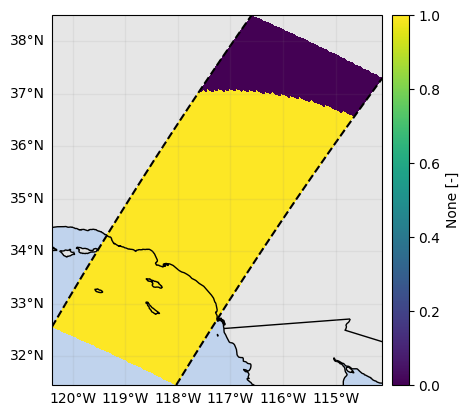

In [ ]:
# Define mask of SR footprints within GR range
r = np.sqrt(x_sr**2 + y_sr**2)
mask_sr_within_gr_range = r < ds_gr["range"].max().item()
mask_sr_within_gr_range.isel(range=-1).gpm.plot_map()

mask_sr_within_gr_range_interval = (r >= min_gr_range_lb) & (r <= max_gr_range_ub)

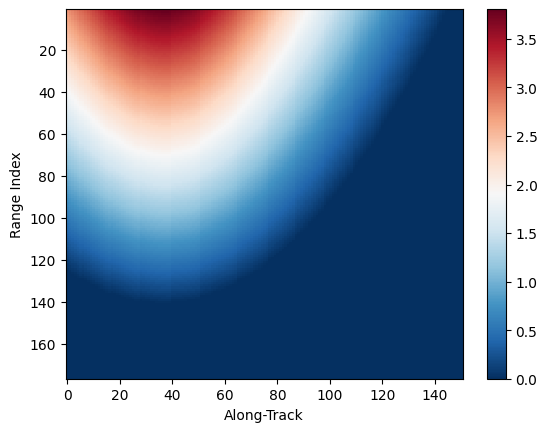

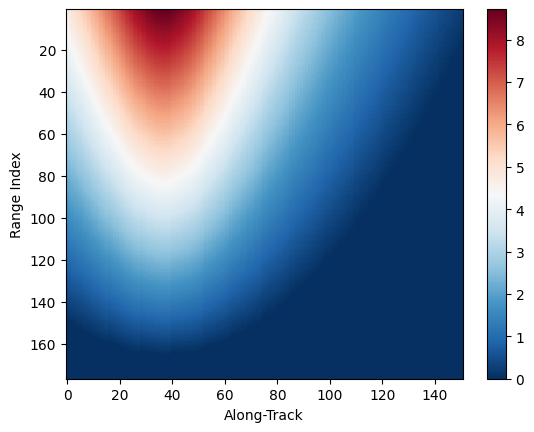

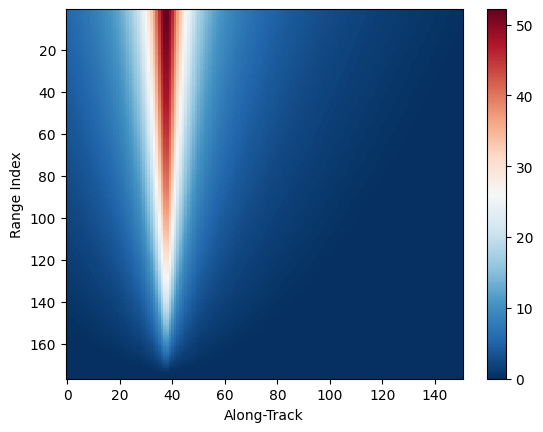

In [ ]:
# Show how elevation angle (of GR) varies along SR scan angles
elevation_sr.isel(cross_track=0).gpm.plot_transect(vmin=0, y="range")
elevation_sr.isel(cross_track=24).gpm.plot_transect(vmin=0, y="range")
elevation_sr.isel(cross_track=-1).gpm.plot_transect(vmin=0, y="range")

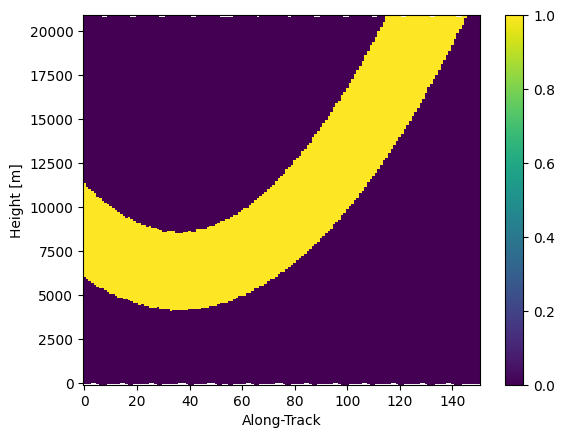

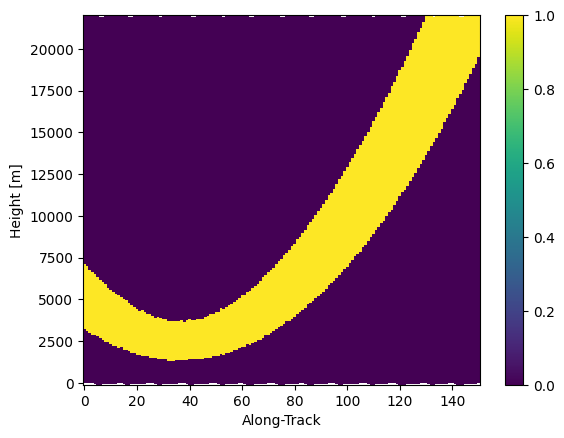

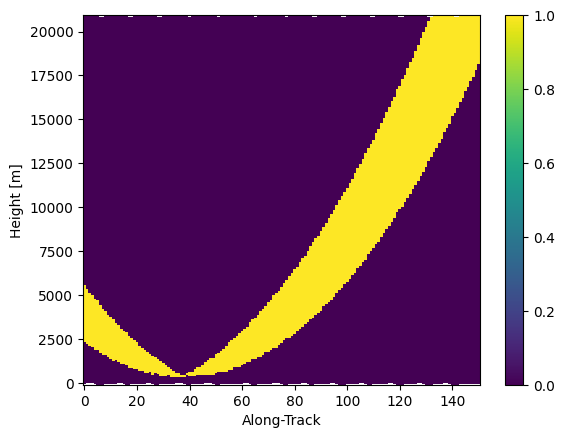

In [ ]:
# Show SR/GR matched elevation
mask_sr_matched_elevation = (elevation_sr >= (ds_gr["sweep_fixed_angle"] - elevation_beamwidth_gr / 2.0)) & (
    elevation_sr <= (ds_gr["sweep_fixed_angle"] + elevation_beamwidth_gr / 2.0)
)
mask_sr_matched_elevation.isel(cross_track=0).gpm.plot_transect()
mask_sr_matched_elevation.isel(cross_track=24).gpm.plot_transect()
mask_sr_matched_elevation.isel(cross_track=-1).gpm.plot_transect()

In [ ]:
# Define mask of SR footprints matching GR gates
mask_ppi = mask_sr_matched_elevation & mask_sr_within_gr_range_interval

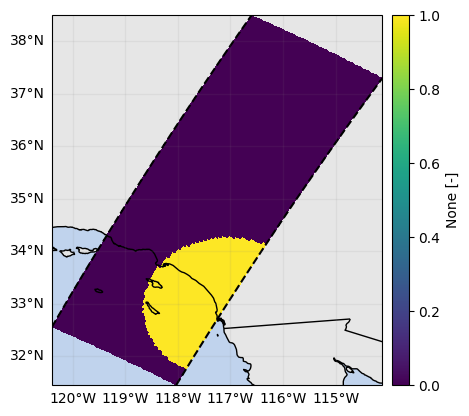

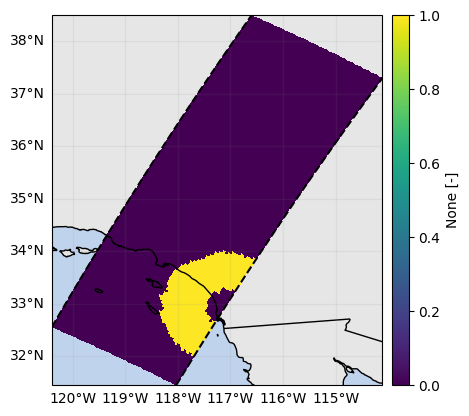

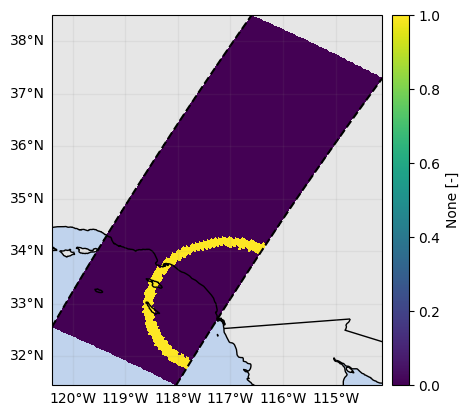

In [ ]:
# Show mask (as SR map)
mask_ppi.any(dim="range").gpm.plot_map(vmin=0)
mask_ppi.isel(range=-10).gpm.plot_map(vmin=0)
mask_ppi.isel(range=-30).gpm.plot_map(vmin=0)

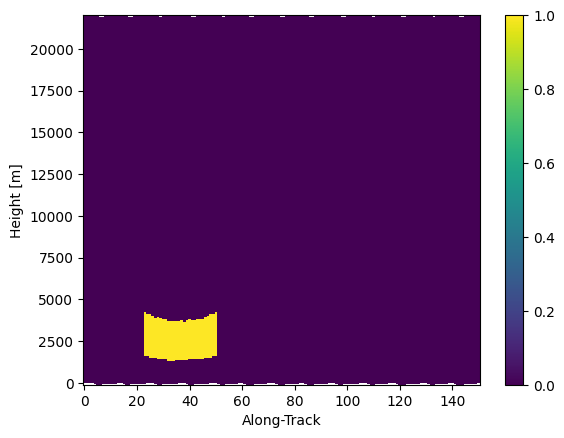

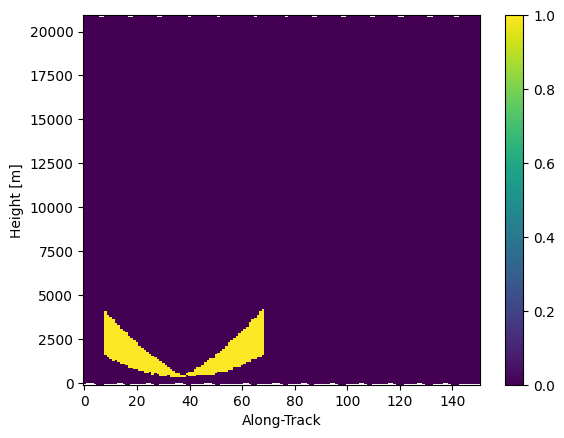

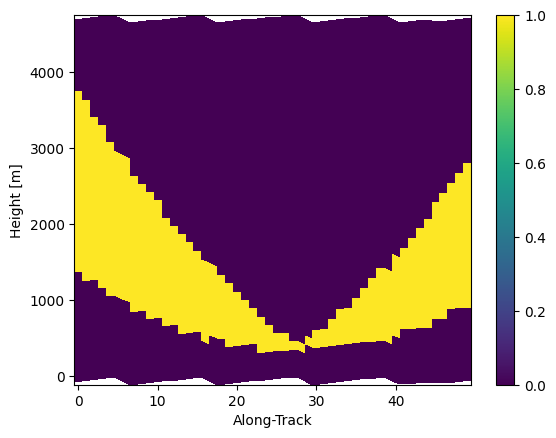

In [ ]:
# Show mask (as SR cross-section)
mask_ppi.isel(cross_track=24).gpm.plot_transect()
mask_ppi.isel(cross_track=-1).gpm.plot_transect()
mask_ppi.isel(cross_track=-1, along_track=slice(10, 60), range=slice(-40, None)).gpm.plot_transect()

## Define SR Masks 

Here we start by defining and analysing various SR masks that can be used to subset SR footprints to be matched with the GR sweep. 

In [ ]:
# Select scan with "normal" dataQuality (for entire cross-track scan)
mask_sr_quality = ds_sr["dataQuality"] == 0

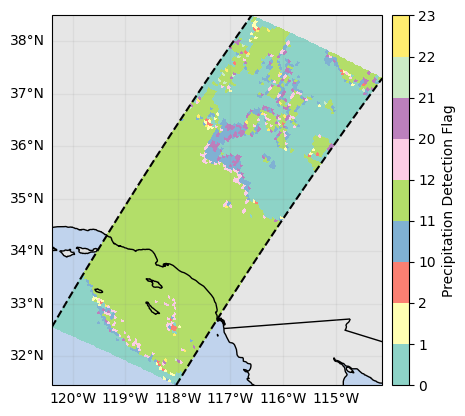

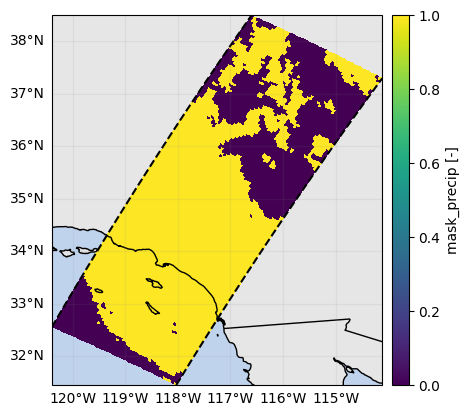

In [ ]:
# Select beams with detected precipitation
ds_sr["flagPrecip"].attrs
ds_sr["flagPrecip"].gpm.plot_map()
mask_sr_precip = ds_sr["flagPrecip"] > 0
mask_sr_precip.name = "mask_precip"
mask_sr_precip.gpm.plot_map()

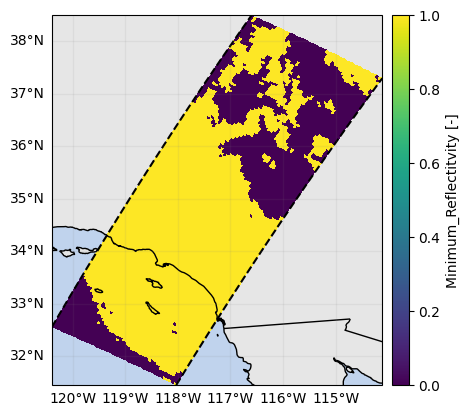

In [ ]:
# Select above minimum SR reflectivity
mask_sr_minimum_z = ds_sr["zFactorFinal"] > z_min_threshold_sr
mask_sr_minimum_z.name = "Minimum_Reflectitvity"
mask_sr_minimum_z.any(dim="range").gpm.plot_map()

In [ ]:
# Select only 'normal' data
# mask_sr_quality_data = ds_sr["qualityData"] == 0
# mask_sr_quality_data.gpm.plot_map()

In [ ]:
# Select only 'high quality' data
# - qualityFlag derived from qualityData.
# - qualityFlag == 1 indicates low quality retrievals
# - qualityFlag == 2 indicates bad/missing retrievals
mask_sr_quality_data = ds_sr["qualityFlag"] == 0

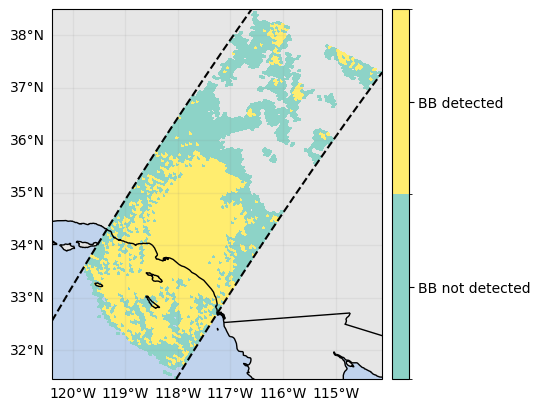

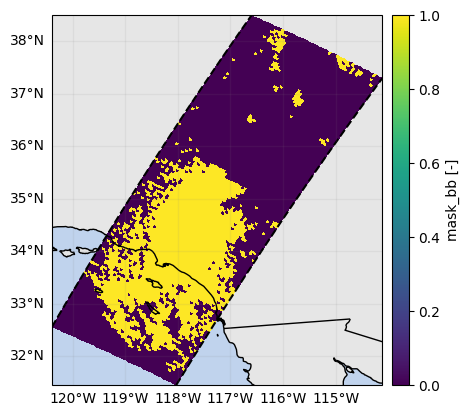

In [ ]:
# Select only beams with detected bright band
ds_sr["qualityBB"].gpm.plot_map()
mask_sr_quality_bb = ds_sr["qualityBB"] == 1
mask_sr_quality_bb.name = "mask_bb"
mask_sr_quality_bb.gpm.plot_map()

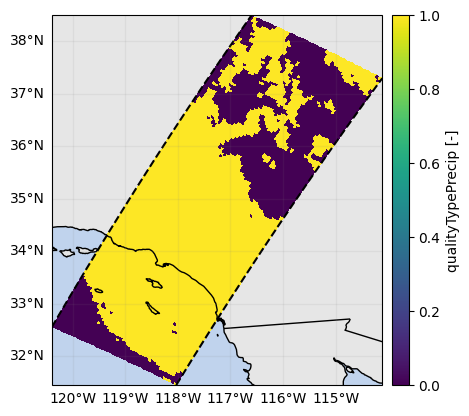

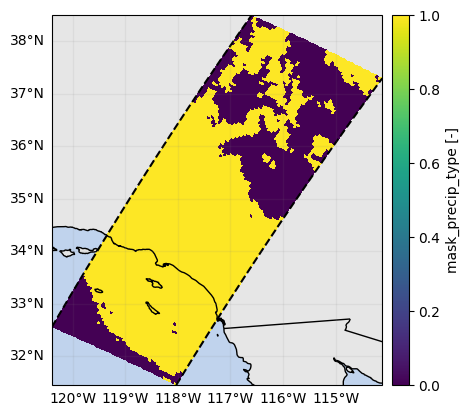

In [ ]:
# Select only beams with confident precipitation type
ds_sr["qualityTypePrecip"].gpm.plot_map()
mask_sr_quality_precip = ds_sr["qualityTypePrecip"] == 1
mask_sr_quality_precip.name = "mask_precip_type"
mask_sr_quality_precip.gpm.plot_map()

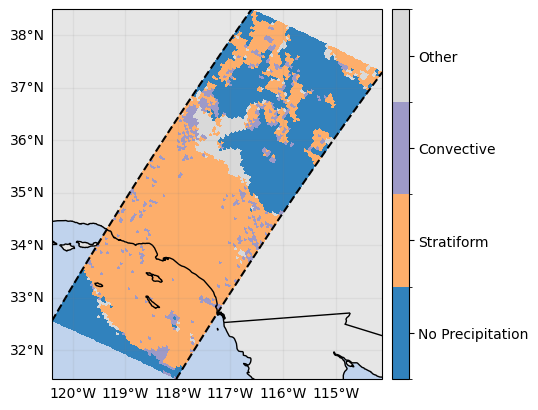

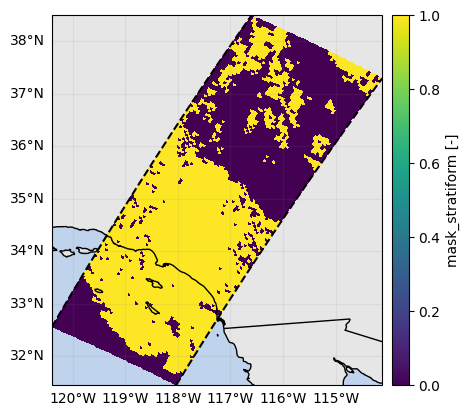

In [ ]:
# Select only stratiform precipitation
ds_sr["flagPrecipitationType"].gpm.plot_map()
mask_sr_stratiform = ds_sr["flagPrecipitationType"] == 1
mask_sr_stratiform.name = "mask_stratiform"
mask_sr_stratiform.gpm.plot_map()

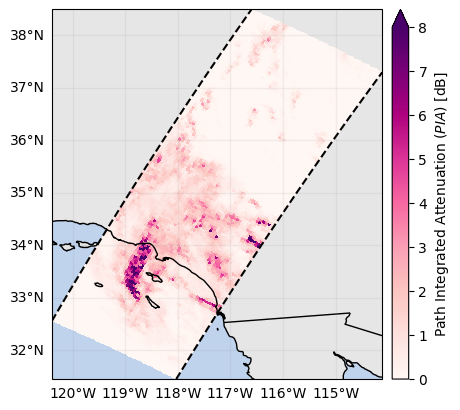

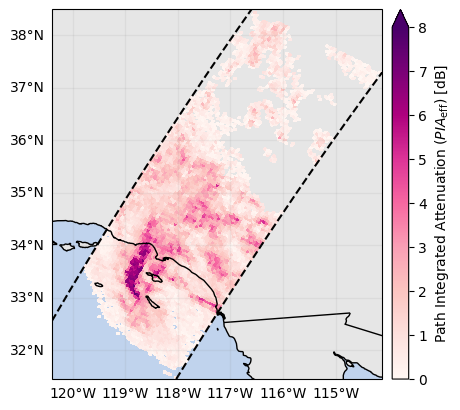

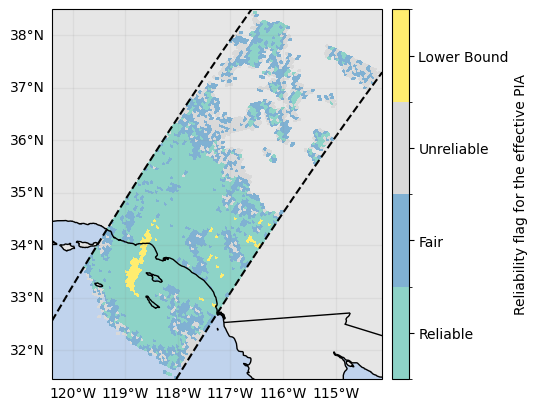

In [ ]:
# Select only beams with reduced path attenuation
# ...
ds_sr["piaFinal"].gpm.plot_map()  # PIA from DSD module
ds_sr["pathAtten"].gpm.plot_map()  # PIAeff
ds_sr["reliabFlag"].gpm.plot_map()  # reliability of PIAeff

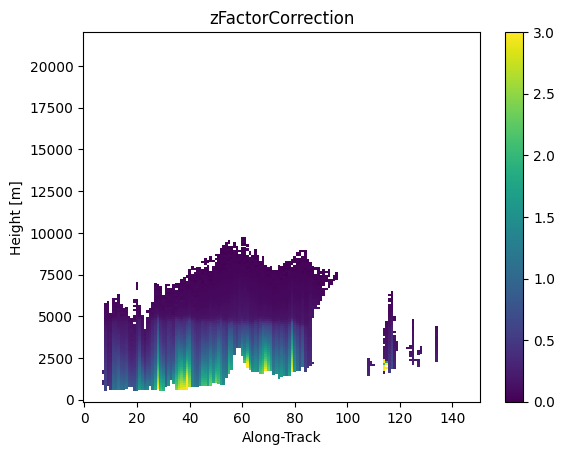

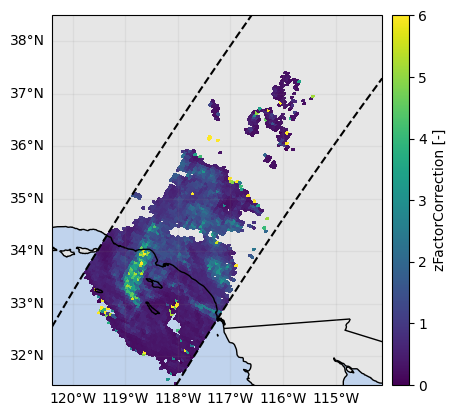

In [ ]:
# Select only beams with limited attenuation correction
# ...
ds_sr["zFactorCorrection"].isel(cross_track=24).gpm.plot_transect(vmin=0, vmax=3, zoom=False)
ds_sr["zFactorCorrection"].isel(range=-20).gpm.plot_map(vmin=0, vmax=6)

Here we define the actual SR mask used to select the SR footprints on which the SR/GR matching will be performed.
Once again, we suggest to avoid, at this stage, being too restrictive in the selection of SR footprints.

1305

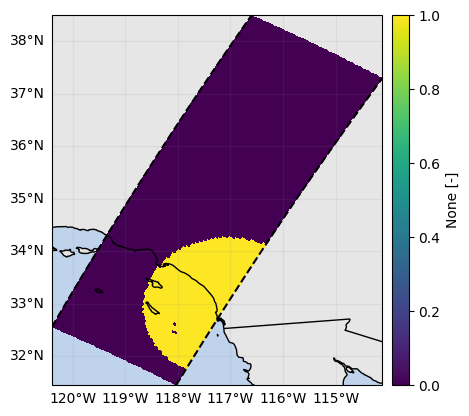

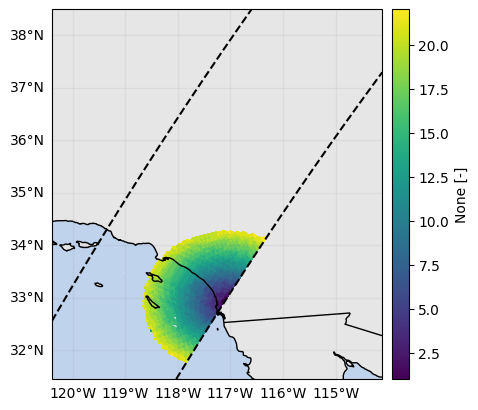

In [ ]:
# Define 3D mask of SR gates matching GR PPI gates
# - TIP: do not mask eccessively here ... but rather at final stage
mask_matched_ppi_3d = mask_ppi & mask_sr_precip & mask_sr_quality

# Define 2D mask of SR beams matching the GR PPI
mask_matched_ppi_2d = mask_matched_ppi_3d.any(dim="range")
mask_matched_ppi_2d.gpm.plot_map()

# Number of matching SR gates per beam
n_matching_sr_gates = mask_matched_ppi_3d.sum(dim="range")
n_matching_sr_gates.where(n_matching_sr_gates > 0).gpm.plot_map()

# Beam indices with at least one matching bin
cross_track_indices, along_track_indices = np.where(mask_matched_ppi_3d.sum(dim="range"))

# Number of beams with at least one valid bin
len(along_track_indices)

## Aggregate SR radar gates

In this subsection, we aggregate SR radar gates intersecting the GR sweep.

SR reflectivities are averaged along the SR beam (approximately vertically) between the half-power points of the GR sweep.

To select SR radar gates for aggregation, the following criteria must be met:
- The SR footprints must contain precipitation.
- The SR radar gates must overlap with GR gates.
- The SR radar gates must fall within a specified GR range distance, defined by `min_gr_range` and `max_gr_range`.
The `min_gr_range` ensures that the GR beamwidth is not smaller than the SR gate spacing.

Important Notes:
- Reflectivity must not be aggregated in dBZ, but rather in mm6 m−3

In [ ]:
# Add variables to SR dataset
ds_sr["zFactorMeasured_Ku"] = ds_sr["zFactorMeasured"]
ds_sr["zFactorFinal_Ku"] = ds_sr["zFactorFinal"]
ds_sr["zFactorFinal_S"] = da_z_s_final
ds_sr["zFactorMeasured_S"] = da_z_s_measured
ds_sr["zFactorCorrection_Ku"] = ds_sr["zFactorCorrection"]
ds_sr["zFactorCorrection_S"] = da_z_s_correction
ds_sr["hres"] = h_res_sr
ds_sr["vres"] = v_res_sr
ds_sr["gate_volume"] = vol_sr
ds_sr["x"] = x_sr
ds_sr["y"] = y_sr
ds_sr["z"] = z_sr

# Compute path-integrated reflectivities
ds_sr["zFactorFinal_Ku_cumsum"] = ds_sr["zFactorFinal"].gpm.idecibel.cumsum("range").gpm.decibel
ds_sr["zFactorFinal_Ku_cumsum"] = ds_sr["zFactorFinal_Ku_cumsum"].where(np.isfinite(ds_sr["zFactorFinal_Ku_cumsum"]))
ds_sr["zFactorMeasured_Ku_cumsum"] = ds_sr["zFactorMeasured"].gpm.idecibel.cumsum("range").gpm.decibel
ds_sr["zFactorMeasured_Ku_cumsum"] = ds_sr["zFactorMeasured_Ku_cumsum"].where(
    np.isfinite(ds_sr["zFactorMeasured_Ku_cumsum"]),
)
ds_sr["zFactorFinal_S_cumsum"] = ds_sr["zFactorFinal_S"].gpm.idecibel.cumsum("range").gpm.decibel
ds_sr["zFactorFinal_S_cumsum"] = ds_sr["zFactorFinal_S_cumsum"].where(np.isfinite(ds_sr["zFactorFinal_S_cumsum"]))
ds_sr["zFactorMeasured_S_cumsum"] = ds_sr["zFactorMeasured_S"].gpm.idecibel.cumsum("range").gpm.decibel
ds_sr["zFactorMeasured_S_cumsum"] = ds_sr["zFactorMeasured_S_cumsum"].where(
    np.isfinite(ds_sr["zFactorMeasured_S_cumsum"]),
)

# Add variables to the spaceborne dataset
z_variables = ["zFactorFinal_Ku", "zFactorFinal_S", "zFactorMeasured_Ku", "zFactorMeasured_S"]
sr_variables = [
    *z_variables,
    "zFactorCorrection_Ku",
    "zFactorCorrection_S",
    "precipRate",
    "airTemperature",
    "zFactorFinal_Ku_cumsum",
    "zFactorMeasured_Ku_cumsum",
    "zFactorFinal_S_cumsum",
    "zFactorMeasured_S_cumsum",
    "hres",
    "vres",
    "gate_volume",
    "x",
    "y",
    "z",
]

# Initialize Dataset where to add aggregated SR gates
ds_sr_match_ppi = xr.Dataset()

# Mask SR gates not matching the GR PPI
ds_sr_ppi = ds_sr[sr_variables].where(mask_matched_ppi_3d)

# Compute aggregation statistics
ds_sr_ppi_min = ds_sr_ppi.min("range")
ds_sr_ppi_max = ds_sr_ppi.max("range")
ds_sr_ppi_sum = ds_sr_ppi.sum(dim="range", skipna=True)
ds_sr_ppi_mean = ds_sr_ppi.mean("range")
ds_sr_ppi_std = ds_sr_ppi.std("range")

# Aggregate reflectivities (in mm6/mm3)
for var in z_variables:
    ds_sr_ppi_mean[var] = ds_sr_ppi[var].gpm.idecibel.mean("range").gpm.decibel
    ds_sr_ppi_std[var] = ds_sr_ppi[var].std("range")  # if only 1 value --> with log, std=0 would become -inf

# Compute counts and fractions above sensitivity thresholds
sr_sensitivity_thresholds = [10, 12, 14, 16, 18]
ds_sr_match_ppi["SR_counts"] = mask_matched_ppi_3d.sum(dim="range")
ds_sr_match_ppi["SR_counts_valid"] = (~np.isnan(ds_sr_ppi["zFactorFinal_Ku"])).sum(dim="range")
for var in z_variables:
    for thr in sr_sensitivity_thresholds:
        fraction = (ds_sr_ppi[var] >= thr).sum(dim="range") / ds_sr_match_ppi["SR_counts"]
        ds_sr_match_ppi[f"SR_{var}_fraction_above_{thr}dBZ"] = fraction

# Compute fraction of hydrometeor types
da_hydro_class = ds_sr["flagHydroClass"].where(mask_matched_ppi_3d)
ds_sr_match_ppi["SR_fraction_no_precip"] = (da_hydro_class == 0).sum(dim="range") / ds_sr_match_ppi["SR_counts"]
ds_sr_match_ppi["SR_fraction_rain"] = (da_hydro_class == 1).sum(dim="range") / ds_sr_match_ppi["SR_counts"]
ds_sr_match_ppi["SR_fraction_snow"] = (da_hydro_class == 2).sum(dim="range") / ds_sr_match_ppi["SR_counts"]
ds_sr_match_ppi["SR_fraction_hail"] = (da_hydro_class == 3).sum(dim="range") / ds_sr_match_ppi["SR_counts"]
ds_sr_match_ppi["SR_fraction_melting_layer"] = (da_hydro_class == 4).sum(dim="range") / ds_sr_match_ppi["SR_counts"]
ds_sr_match_ppi["SR_fraction_clutter"] = (da_hydro_class == 5).sum(dim="range") / ds_sr_match_ppi["SR_counts"]
ds_sr_match_ppi["SR_fraction_below_isotherm"] = (ds_sr_ppi["airTemperature"] >= 273.15).sum(
    dim="range",
) / ds_sr_match_ppi["SR_counts"]
ds_sr_match_ppi["SR_fraction_above_isotherm"] = (ds_sr_ppi["airTemperature"] < 273.15).sum(
    dim="range",
) / ds_sr_match_ppi["SR_counts"]

# Add aggregation statistics
for var in ds_sr_ppi_mean.data_vars:
    ds_sr_match_ppi[f"SR_{var}_mean"] = ds_sr_ppi_mean[var]
for var in ds_sr_ppi_std.data_vars:
    ds_sr_match_ppi[f"SR_{var}_std"] = ds_sr_ppi_std[var]
for var in ds_sr_ppi_sum.data_vars:
    ds_sr_match_ppi[f"SR_{var}_sum"] = ds_sr_ppi_sum[var]
for var in ds_sr_ppi_max.data_vars:
    ds_sr_match_ppi[f"SR_{var}_max"] = ds_sr_ppi_max[var]
for var in ds_sr_ppi_min.data_vars:
    ds_sr_match_ppi[f"SR_{var}_min"] = ds_sr_ppi_min[var]
for var in ds_sr_ppi_min.data_vars:
    ds_sr_match_ppi[f"SR_{var}_range"] = ds_sr_ppi_max[var] - ds_sr_ppi_min[var]

# Compute coefficient of variation
for var in z_variables:
    ds_sr_match_ppi[f"SR_{var}_cov"] = ds_sr_match_ppi[f"SR_{var}_std"] / ds_sr_match_ppi[f"SR_{var}_mean"]

# Add SR L2 variables (useful for final filtering and analysis)
var_l2 = [
    "flagPrecip",
    "flagPrecipitationType",
    "dataQuality",
    "sunLocalTime",
    "SCorientation",
    "qualityFlag",
    "qualityTypePrecip",
    "qualityBB",
    "pathAtten",
    "piaFinal",
    "reliabFlag",
]
for var in var_l2:
    ds_sr_match_ppi[f"SR_{var}"] = ds_sr[var]

# Add SR time
ds_sr_match_ppi["SR_time"] = ds_sr_match_ppi["time"]
ds_sr_match_ppi = ds_sr_match_ppi.drop("time")

# Mask SR beams not matching the GR PPI
ds_sr_match_ppi = ds_sr_match_ppi.where(mask_matched_ppi_2d)

# Remove unecessary coordinates
unecessary_coords = [
    "radar_frequency",
    "sweep_mode",
    "prt_mode",
    "follow_mode",
    "latitude",
    "longitude",
    "altitude",
    "crs_wkt",
    "time",
    "crsWGS84",
    "dataQuality",
    "sunLocalTime",
    "SCorientation",
]
for coord in unecessary_coords:
    if coord in ds_sr_match_ppi:
        ds_sr_match_ppi = ds_sr_match_ppi.drop(coord)
    if coord in mask_matched_ppi_2d.coords:
        mask_matched_ppi_2d = mask_matched_ppi_2d.drop(coord)

# Stack aggregated dataset to beam dimension index
ds_sr_stack = ds_sr_match_ppi.stack(sr_beam_index=("along_track", "cross_track"))
da_mask_matched_ppi_stack = mask_matched_ppi_2d.stack(sr_beam_index=("along_track", "cross_track"))

# Drop beams not matching the GR PPI
ds_sr_match = ds_sr_stack.isel(sr_beam_index=da_mask_matched_ppi_stack)

## Display aggregated SR variables  

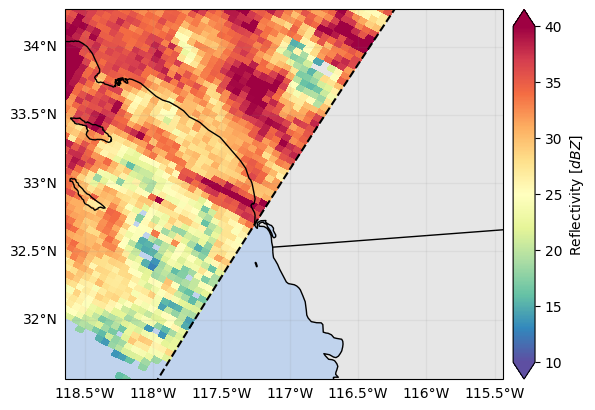

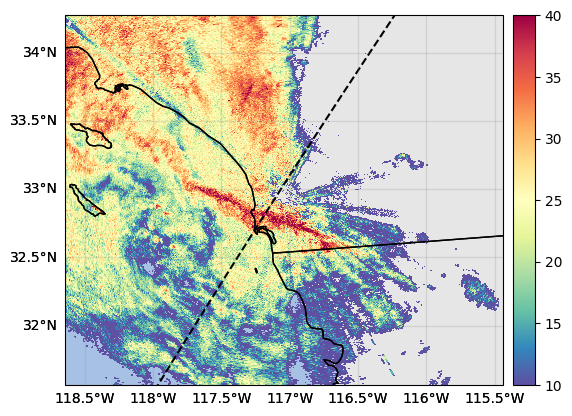

In [ ]:
# Original SR near surface reflectivity
p = ds_sr["zFactorFinalNearSurface"].gpm.plot_map(cmap=cmap, vmin=10, vmax=40)
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))

# Original GR reflectivities
p = ds_gr["DBZH"].where(mask_gr).xradar_dev.plot_map(cmap=cmap, vmin=10, vmax=40)
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))
ds_sr.gpm.plot_swath_lines(ax=p.axes)

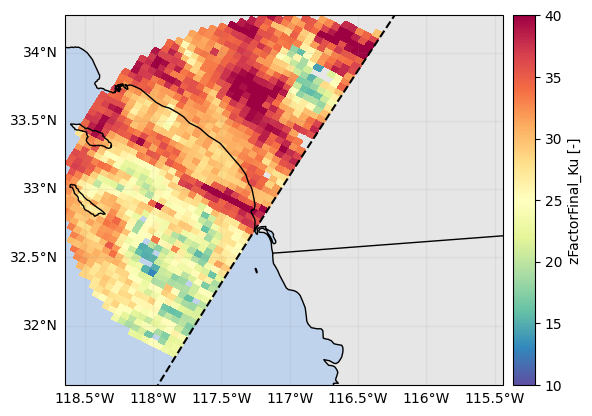

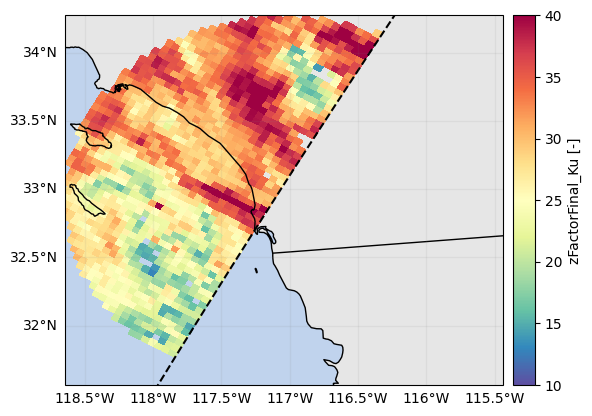

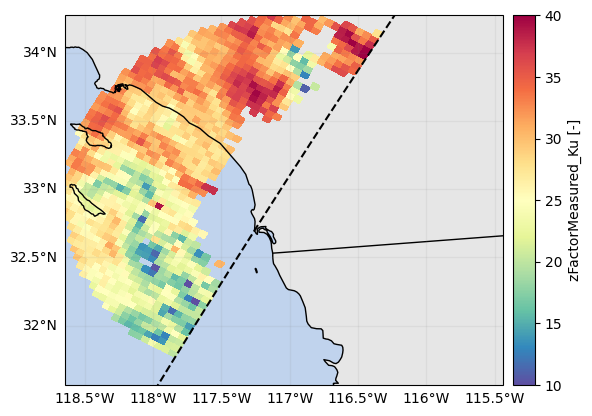

In [ ]:
# SR reflectivity statistics matching the GR PPI (using xr.Dataset)
p = ds_sr_ppi_max["zFactorFinal_Ku"].gpm.plot_map(cmap=cmap, vmin=10, vmax=40)
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))

p = ds_sr_ppi_mean["zFactorFinal_Ku"].gpm.plot_map(cmap=cmap, vmin=10, vmax=40)
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))

p = ds_sr_ppi_mean["zFactorMeasured_Ku"].gpm.plot_map(cmap=cmap, vmin=10, vmax=40)
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))

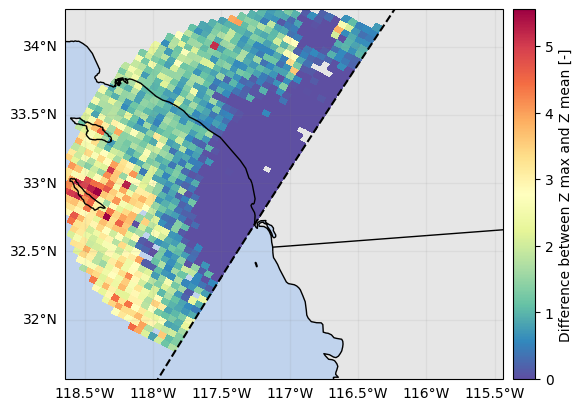

In [ ]:
# Show difference between using Ku mean and max !
diff = ds_sr_ppi_max["zFactorFinal_Ku"] - ds_sr_ppi_mean["zFactorFinal_Ku"]
diff.name = "Difference between Z max and Z mean"
p = diff.gpm.plot_map(cmap="Spectral_r")
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))

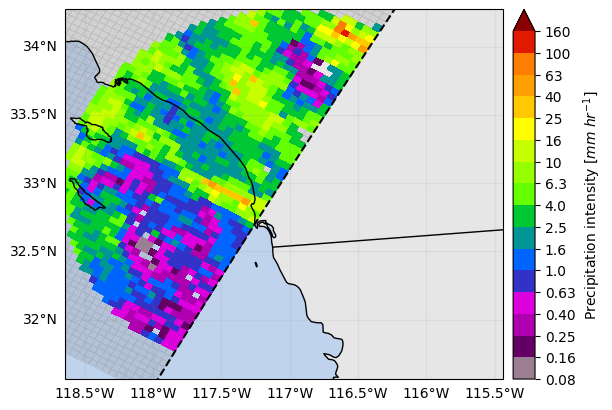

In [ ]:
# Show SR mean precip rate
p = ds_sr_ppi_mean["precipRate"].gpm.plot_map()
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))

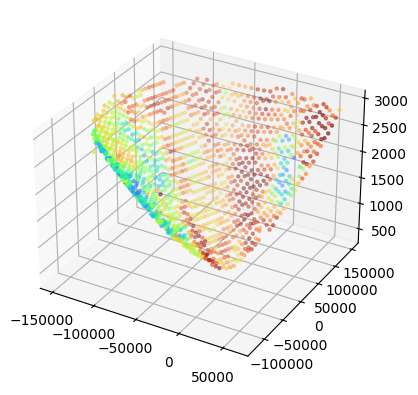

In [ ]:
# Display reflectivity in 3D

fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")
ax.scatter(
    ds_sr_match["SR_x_mean"].values,
    ds_sr_match["SR_y_mean"].values,
    ds_sr_match["SR_z_mean"].values,
    c=ds_sr_match["SR_zFactorFinal_Ku_mean"].values,
    cmap="turbo",
    vmin=10,
    vmax=40,
    s=5,
)

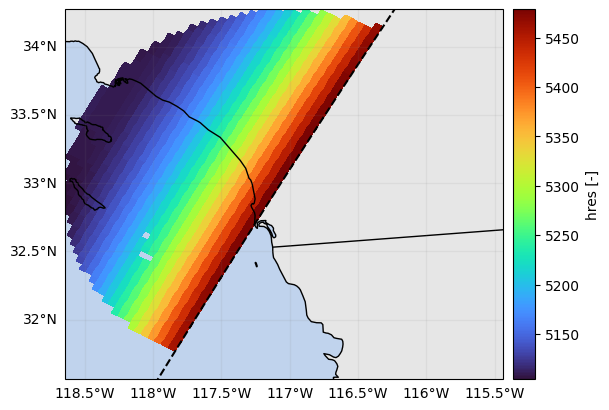

In [ ]:
# Disply SR footprint horizontal resolution
p = ds_sr_ppi_max["hres"].gpm.plot_map(cmap="turbo")
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))
plt.show()

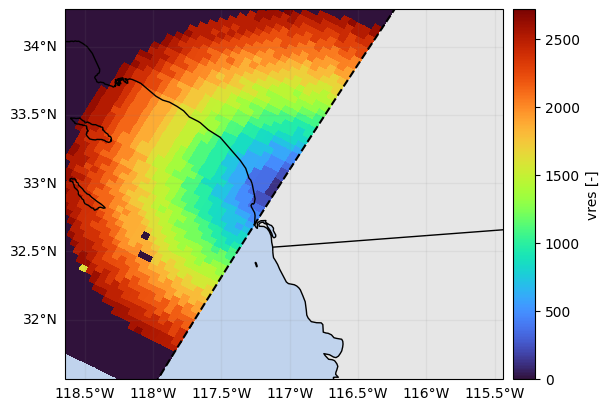

In [ ]:
# Display SR depth over which data are integrated
p = ds_sr_ppi_sum["vres"].gpm.plot_map(cmap="turbo")
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))
plt.show()

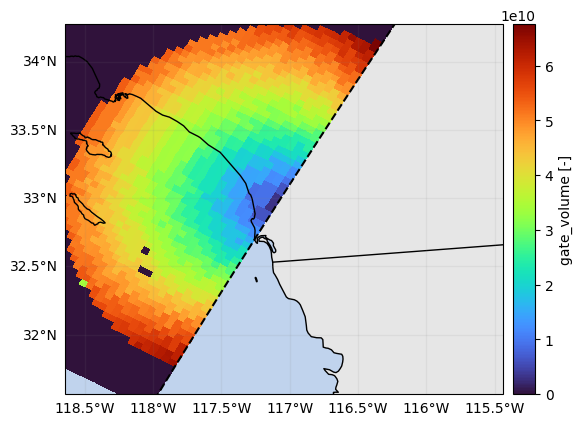

In [ ]:
# Display SR volume over which data are integrated
p = ds_sr_ppi_sum["gate_volume"].gpm.plot_map(cmap="turbo")
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))
plt.show()

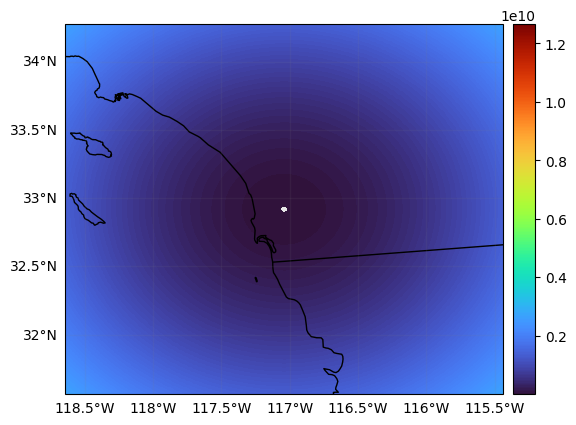

In [ ]:
# Display GR radar volume
p = vol_gr.xradar_dev.plot_map(cmap="turbo")
p.axes.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))
plt.show()

##  Retrieve the SR footprints polygons

Here we retrieve SR footprints polygons and then we construct a `geopandas.DataFrame` with the aggregated SR reflectivities.

In [ ]:
# Retrieve SR footprint polygons (using the footprint radius in AEQD x,y coordinates)
xy_mean_sr = np.stack([ds_sr_match["SR_x_mean"], ds_sr_match["SR_y_mean"]], axis=-1)
footprint_radius = ds_sr_match["SR_hres_max"].values / 2
sr_poly = [Point(x, y).buffer(footprint_radius[i]) for i, (x, y) in enumerate(xy_mean_sr)]

In [ ]:
# Create geopandas DataFrame
df_sr_match = ds_sr_match.to_dataframe()
gdf_sr = gpd.GeoDataFrame(df_sr_match, crs=crs_gr, geometry=sr_poly)
gdf_sr.columns

Index(['SR_counts', 'SR_counts_valid',
       'SR_zFactorFinal_Ku_fraction_above_10dBZ',
       'SR_zFactorFinal_Ku_fraction_above_12dBZ',
       'SR_zFactorFinal_Ku_fraction_above_14dBZ',
       'SR_zFactorFinal_Ku_fraction_above_16dBZ',
       'SR_zFactorFinal_Ku_fraction_above_18dBZ',
       'SR_zFactorFinal_S_fraction_above_10dBZ',
       'SR_zFactorFinal_S_fraction_above_12dBZ',
       'SR_zFactorFinal_S_fraction_above_14dBZ',
       ...
       'lat', 'gpm_id', 'gpm_granule_id', 'gpm_cross_track_id',
       'gpm_along_track_id', 'sweep_number', 'sweep_fixed_angle',
       'along_track', 'cross_track', 'geometry'],
      dtype='object', length=165)

In [ ]:
# Extract radar gate polygon on the range-azimuth axis
sr_poly = np.array(gdf_sr.geometry)

## Retrieve the GR gates polygons

Here we retrieve GR gates polygons and then we construct a `geopandas.DataFrame` containing the GR measurements.

Currently the GR gates polygons are derived inferring the quadmesh around the GR gate centroids (using the x and y GR CRS coordinates).

More accurate GR gates polygons could be derived using the GR beamwidth. We welcome contributions addressing this point !

In [ ]:
# Add variables to GR dataset
ds_gr["gate_volume"] = vol_gr
ds_gr["vres"] = v_res_gr
ds_gr["hres"] = h_res_gr

# Add path_integrated_reflectivities
ds_gr["DBZH_cumsum"] = ds_gr["DBZH"].gpm.idecibel.cumsum("range").gpm.decibel
ds_gr["DBZH_cumsum"] = ds_gr["DBZH_cumsum"].where(np.isfinite(ds_gr["DBZH_cumsum"]))

# Mask reflectivites above minimum GR Z threshold
mask_gr = ds_gr["DBZH"] > z_min_threshold_gr  # important !

# Subset gates in range distance interval
ds_gr_subset = ds_gr.sel(range=slice(min_gr_range_lb, max_gr_range_ub)).where(mask_gr)

# Retrieve geopandas dataframe
gdf_gr = ds_gr_subset.xradar_dev.to_geopandas()  # here we currently infer the quadmesh using the x,y coordinates
display(gdf_gr)

DBZH      ZDR       PHIDP     RHOHV  CCORH   gate_volume  \
azimuth    range                                                                
0.252686   2125.0     NaN      NaN         NaN       NaN    NaN           NaN   
           2375.0     NaN      NaN         NaN       NaN    NaN           NaN   
           2625.0     NaN      NaN         NaN       NaN    NaN           NaN   
           2875.0     NaN      NaN         NaN       NaN    NaN           NaN   
           3125.0     NaN      NaN         NaN       NaN    NaN           NaN   
...                   ...      ...         ...       ...    ...           ...   
359.744568 148875.0  32.0 -12.9375  180.529594  1.051667   -8.0  1.325715e+09   
           149125.0  27.0 -12.9375   90.617394  0.528333   -8.0  1.330171e+09   
           149375.0  29.5 -12.9375  271.146988  1.018333   -8.0  1.334635e+09   
           149625.0  27.5 -12.9375   90.617394  0.845000   -8.0  1.339106e+09   
           149875.0  29.5 -12.9375    0.352597  1.011667   -6.0  1.343585e+09   

                            vres         hres  DBZH_cumsum  elevation  ...  \
azimuth    range                                                       ...   
0.252686   2125.0            NaN          NaN          NaN   0.483398  ...   
           2375.0            NaN          NaN          NaN   0.483398  ...   
           2625.0            NaN          NaN          NaN   0.483398  ...   
           2875.0            NaN          NaN          NaN   0.483398  ...   
           3125.0            NaN          NaN          NaN   0.483398  ...   
...                          ...          ...          ...        ...  ...   
359.744568 148875.0  2598.424805  2598.424805    54.805861   0.483398  ...   
           149125.0  2602.788330  2602.788330    54.813053   0.483398  ...   
           149375.0  2607.151855  2607.151855    54.825813   0.483398  ...   
           149625.0  2611.515137  2611.515137    54.833845   0.483398  ...   
           149875.0  2615.878662  2615.878662    54.846543   0.483398  ...   

                    sweep_fixed_angle  crs_wkt           x              y  \
azimuth    range                                                            
0.252686   2125.0            0.483398        0    9.370927    2124.819145   
           2375.0            0.483398        0   10.473386    2374.797266   
           2625.0            0.483398        0   11.575845    2624.775259   
           2875.0            0.483398        0   12.678303    2874.753123   
           3125.0            0.483398        0   13.780761    3124.730858   
...                               ...      ...         ...            ...   
359.744568 148875.0          0.483398        0 -663.487562  148825.386039   
           149125.0          0.483398        0 -664.601337  149075.214475   
           149375.0          0.483398        0 -665.715111  149325.042530   
           149625.0          0.483398        0 -666.828883  149574.870202   
           149875.0          0.483398        0 -667.942653  149824.697491   

                               z         lon        lat     range     azimuth  \
azimuth    range                                                                
0.252686   2125.0     338.193914 -117.041701  32.938177    2125.0    0.252686   
           2375.0     340.369314 -117.041689  32.940431    2375.0    0.252686   
           2625.0     342.552070 -117.041678  32.942685    2625.0    0.252686   
           2875.0     344.742182 -117.041666  32.944939    2875.0    0.252686   
           3125.0     346.939649 -117.041654  32.947193    3125.0    0.252686   
...                          ...         ...        ...       ...         ...   
359.744568 148875.0  2879.986614 -117.049005  34.260814  148875.0  359.744568   
           149125.0  2886.478208 -117.049017  34.263066  149125.0  359.744568   
           149375.0  2892.977147 -117.049029  34.265318  149375.0  359.744568   
           149625.0  2899.483431 -117.049042  34.267571  14

In [ ]:
# Extract radar gate polygon on the range-azimuth axis
gr_poly = np.array(gdf_gr.geometry)

## Aggregate GR data on SR footprints

To aggregate GR radar gates onto SR beam polygon footprints, we will use the `PolyAggregator`. 
The `PolyAggregator` enable custom aggregation of source (GR) polygons data intesecting the target (SR) polygons.

When aggregating the data, you can use a combination of weighting schemes
By default, `PolyAggregator` applies **area_weighting**, which assigns weights based on the proportion of 
source polygon area that intersects the target polygon.

**Custom Weighting Schemes**

Several additional weighting schemes can be utilized, typically derived as a function of the horizontal distance between the centroids of the source and target polygons. Examples include:

- **Inverse Distance Weighting**: $\text{weights} = \frac{1}{\text{dist}^{\text{order}}}$

- **Barnes Gaussian Weighting**: $\text{weights} = \exp\left(-\frac{\text{dist}^2}{\kappa^2}\right)$

- **Cressman Weighting**: $\text{weights} = \frac{\text{max\_distance}^2 - \text{dist}^2}{\text{max\_distance}^2 + \text{dist}^2}$

For example, the Barnes Gaussian Distance Weighting Scheme weights values proportionally to the distance measured from the center of the SR footprint to the center of the GR radar gate. This approach can partially account  for the nonuniform distribution of 
power within the SR beam.
                                                                                                           
Custom weights can however also be passed to `PolyAggregator`, which will automatically handle normalization.

In the context of SR/GR matching, it may be beneficial to adopt a **Volume Weighting Scheme**, using the volumes of GR radar gates as weights so that larger volumes are weighted more heavily.


In the code here below, we currently apply only the Area Weighting Scheme:

In [ ]:
# Define PolyAggregator
aggregator = PolyAggregator(source_polygons=gr_poly, target_polygons=sr_poly)

In [ ]:
# Aggregate GR reflecitvities and compute statistics
# - Timestep of acquisition
time_gr = aggregator.first(values=gdf_gr["time"])

# - Total number of gates aggregated
counts = aggregator.counts()
counts_valid = aggregator.apply(lambda x, weights: np.sum(~np.isnan(x)), values=gdf_gr["DBZH"])

# - Total gate volume
sum_vol = aggregator.sum(values=gdf_gr["gate_volume"])

# - Fraction of SR area covered
fraction_covered_area = aggregator.fraction_covered_area()

# - Reflectivity statistics
z_mean = wrl.trafo.decibel(aggregator.average(values=wrl.trafo.idecibel(gdf_gr["DBZH"])))
z_std = aggregator.std(values=gdf_gr["DBZH"])
z_max = aggregator.max(values=gdf_gr["DBZH"])
z_min = aggregator.min(values=gdf_gr["DBZH"])
z_range = z_max - z_min
z_cov = z_std / z_mean  # coefficient of variation

Now we create a `geopandas.DataFrame` with aggregated GR statistics:

In [ ]:
# Create DataFrame with GR matched statistics
df = pd.DataFrame(
    {
        "GR_Z_mean": z_mean,
        "GR_Z_std": z_std,
        "GR_Z_max": z_max,
        "GR_Z_min": z_min,
        "GR_Z_range": z_range,
        "GR_Z_cov": z_cov,
        "GR_time": time_gr,
        "GR_gate_volume_sum": sum_vol,
        "GR_fraction_covered_area": fraction_covered_area,
        "GR_counts": counts,
        "GR_counts_valid": counts_valid,
    },
    index=gdf_sr.index,
)
gdf_gr_match = gpd.GeoDataFrame(df, crs=crs_gr, geometry=aggregator.target_polygons)
gdf_gr_match.head()

# Add GR range statistics
gdf_gr_match["GR_range_max"] = aggregator.max(values=gdf_gr["range"])
gdf_gr_match["GR_range_mean"] = aggregator.mean(values=gdf_gr["range"])
gdf_gr_match["GR_range_min"] = aggregator.min(values=gdf_gr["range"])

# Fraction above sensitivity thresholds
gr_sensitivity_thresholds = [8, 10, 12, 14, 16, 18]
for thr in sr_sensitivity_thresholds:
    fraction = aggregator.apply(lambda x, weights: np.sum(x > thr), values=gdf_gr["DBZH"]) / counts
    gdf_gr_match[f"GR_Z_fraction_above_{thr}dBZ"] = fraction

# Compute further aggregation statistics
stats_var = ["vres", "hres", "x", "y", "z", "DBZH_cumsum"]
for var in stats_var:
    gdf_gr_match[f"GR_{var}_mean"] = aggregator.average(values=gdf_gr[var])
    gdf_gr_match[f"GR_{var}_min"] = aggregator.min(values=gdf_gr[var])
    gdf_gr_match[f"GR_{var}_max"] = aggregator.max(values=gdf_gr[var])
    gdf_gr_match[f"GR_{var}_range"] = gdf_gr_match[f"GR_{var}_max"] - gdf_gr_match[f"GR_{var}_min"]

# Compute horizontal distance between centroids
func_dict = {"min": np.min, "mean": np.mean, "max": np.max}
for suffix, func in func_dict.items():
    arr = np.zeros(aggregator.n_target_polygons) * np.nan
    arr[aggregator.target_intersecting_indices] = np.array(
        [func(dist) for i, dist in aggregator.dict_distances.items()],
    )
    gdf_gr_match[f"distance_horizontal_{suffix}"] = arr

--------------------------------------------------------------------------
To compute custom statistics, you can use the following approaches. Remember that the function must have the `values` and `weights` arguments. Add the `weights` argument also if they are not used in your function !

In [ ]:
def weighted_mean(values, weights):
    return np.average(values, weights=weights)


aggregated_values = aggregator.apply(weighted_mean, values=gdf_gr["DBZH"], area_weighting=True)
aggregated_values = aggregator.apply(
    lambda x, weights: np.average(x, weights=weights),
    values=gdf_gr["DBZH"],
    area_weighting=True,
)

Here below we compare the usage of Inverse Distance Weighting, Barnes Gaussian Distance Weighting, Cressman Weighting, and Volume Weighting.

In [ ]:
from gpm.utils.zonal_stats import BarnesGaussianWeights, CressmanWeights, InverseDistanceWeights, PolyAggregator

gdf_gr_match1 = gdf_gr_match.copy()

# Weighted by intersection area
gdf_gr_match1["GR_Z_area"] = aggregator.mean(values=gdf_gr["DBZH"], area_weighting=True)

# Weighted by ntersection area and Inverse Distance Weighting
gdf_gr_match1["GR_Z_idw"] = aggregator.mean(
    values=gdf_gr["DBZH"],
    area_weighting=True,
    distance_weighting=InverseDistanceWeights(order=1),
)
# Weighted by intersection area and Cressman Weighting
gdf_gr_match1["GR_Z_cressman"] = aggregator.mean(
    values=gdf_gr["DBZH"],
    area_weighting=True,
    distance_weighting=CressmanWeights(max_distance=2000),
)
# Weighted by intersection area and Barnes Gaussian Weighting (kappa=SR_hres_mean)
gdf_gr_match1["GR_Z_barnes"] = aggregator.mean(
    values=gdf_gr["DBZH"],
    area_weighting=True,
    distance_weighting=BarnesGaussianWeights(kappa=gdf_sr["SR_hres_mean"]),
)
# Weighted Barnes Gaussian Weighting (kappa=SR_radius_mean)
gdf_gr_match1["GR_Z_barnes_without_area"] = aggregator.mean(
    values=gdf_gr["DBZH"],
    area_weighting=False,
    distance_weighting=BarnesGaussianWeights(kappa=gdf_sr["SR_hres_mean"]),
)
# Weighted by intersection area and by GR volume
gdf_gr_match1["GR_Z_volume"] = aggregator.mean(
    values=gdf_gr["DBZH"],
    weights=gdf_gr["gate_volume"],
    area_weighting=True,
)

<Axes: >

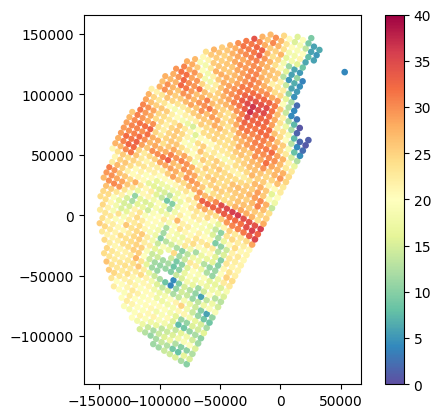

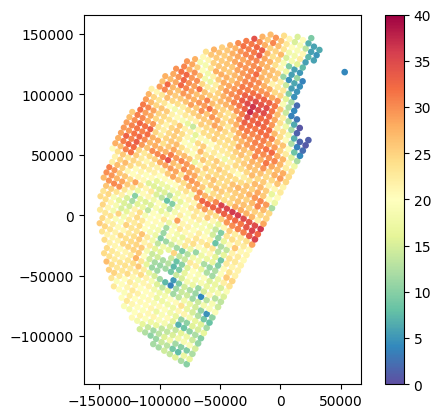

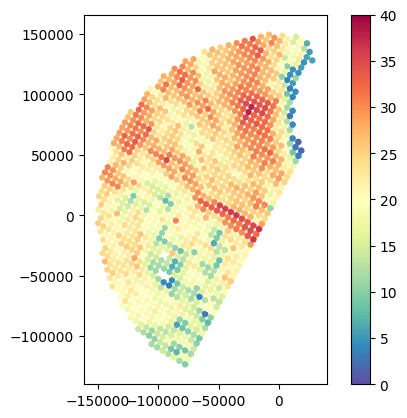

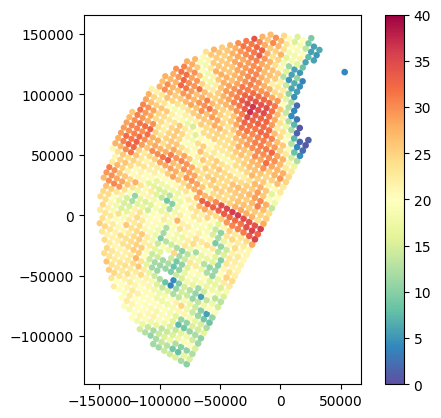

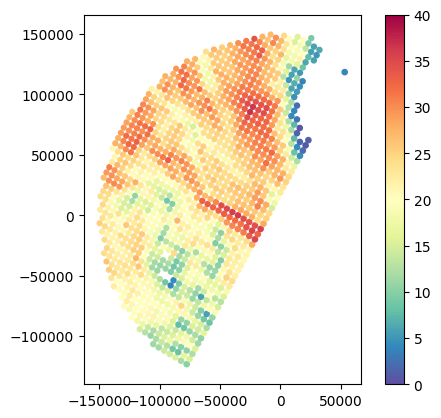

In [ ]:
gdf_gr_match1.plot(column="GR_Z_area", legend=True, cmap="Spectral_r", vmin=0, vmax=40)
gdf_gr_match1.plot(column="GR_Z_idw", legend=True, cmap="Spectral_r", vmin=0, vmax=40)
gdf_gr_match1.plot(column="GR_Z_cressman", legend=True, cmap="Spectral_r", vmin=0, vmax=40)
gdf_gr_match1.plot(column="GR_Z_barnes", legend=True, cmap="Spectral_r", vmin=0, vmax=40)
gdf_gr_match1.plot(column="GR_Z_volume", legend=True, cmap="Spectral_r", vmin=0, vmax=40)

<Axes: >

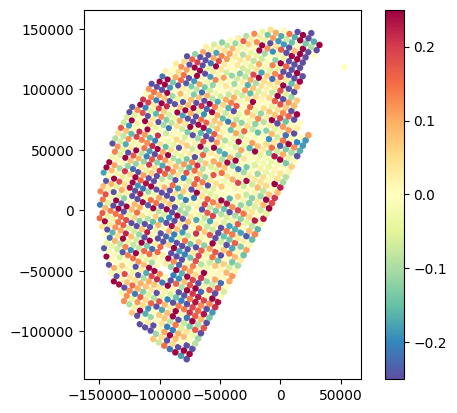

In [ ]:
# Impact of Barnes with and without area-weighting
gdf_gr_match1["DIFF_Barnes_Without_Area"] = gdf_gr_match1["GR_Z_barnes"] - gdf_gr_match1["GR_Z_barnes_without_area"]
gdf_gr_match1.plot(column="DIFF_Barnes_Without_Area", legend=True, cmap="Spectral_r", vmin=-0.25, vmax=0.25)

<Axes: >

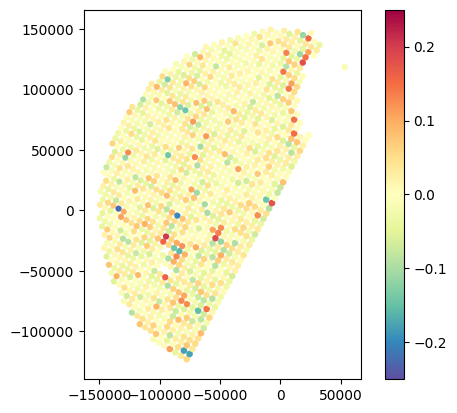

In [ ]:
# Impact of Barnes with area-weighting and default area weighting
gdf_gr_match1["DIFF_Barnes_Naive"] = gdf_gr_match1["GR_Z_area"] - gdf_gr_match1["GR_Z_barnes"]
gdf_gr_match1.plot(column="DIFF_Barnes_Naive", legend=True, cmap="Spectral_r", vmin=-0.25, vmax=0.25)

## Create the SR/GR Database

Let's back to our main task and merge SR/GR aggregated variables into an unique database:

In [ ]:
# Create DataFrame with matched variables
gdf_match = gdf_gr_match.merge(gdf_sr, on="geometry")

# Compute ratio SR/GR volume
gdf_match["VolumeRatio"] = gdf_match["SR_gate_volume_sum"] / gdf_match["GR_gate_volume_sum"]

# Compute difference in SR/GR gate volume
gdf_match["VolumeDiff"] = gdf_match["SR_gate_volume_sum"] - gdf_match["GR_gate_volume_sum"]

# Compute time difference
gdf_match["time_difference"] = gdf_match["GR_time"] - gdf_match["SR_time"]

# Compute lower bound and upper bound height
gdf_match["GR_z_lower_bound"] = gdf_match["GR_z_min"] - gdf_match["GR_vres_mean"] / 2
gdf_match["GR_z_upper_bound"] = gdf_match["GR_z_max"] + gdf_match["GR_vres_mean"] / 2

gdf_match["SR_z_lower_bound"] = gdf_match["SR_z_min"] - gdf_match["SR_vres_mean"] / 2
gdf_match["SR_z_upper_bound"] = gdf_match["SR_z_max"] + gdf_match["SR_vres_mean"] / 2

## Analyse the SR/GR Database

<Axes: >

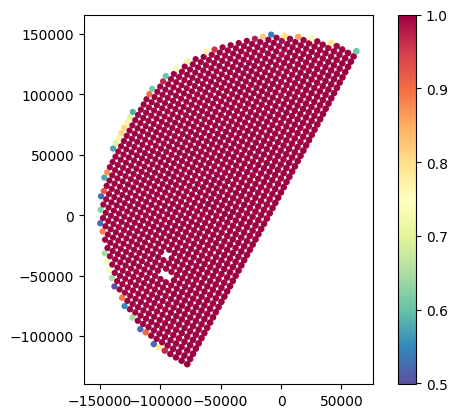

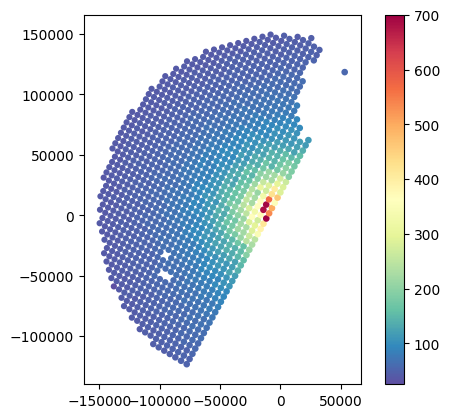

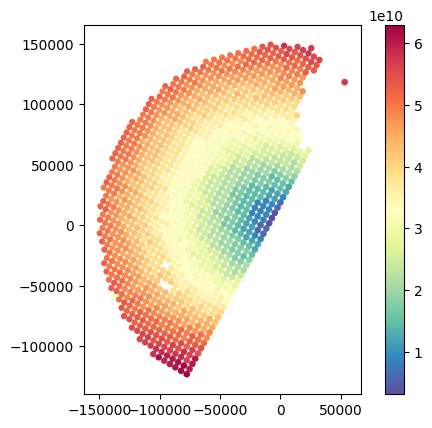

In [ ]:
# Show fraction SR footprint horizontal area covered by GR
gdf_match.plot(column="GR_fraction_covered_area", legend=True, cmap="Spectral_r")

# Show ratio SR/GR volume
gdf_match.plot(column="VolumeRatio", legend=True, cmap="Spectral_r")

# Show difference in total gate volume
gdf_match.plot(column="VolumeDiff", legend=True, cmap="Spectral_r")

<Axes: >

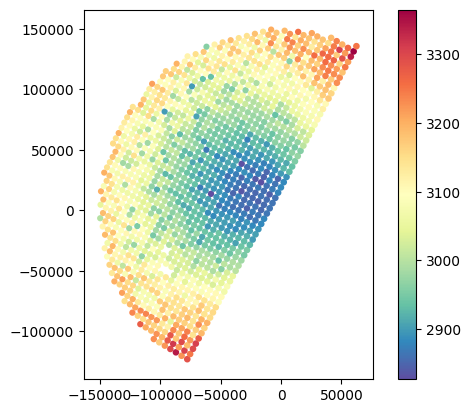

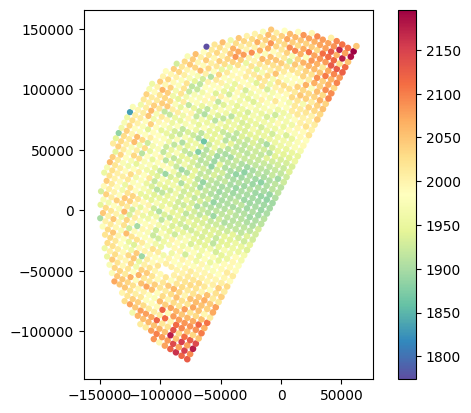

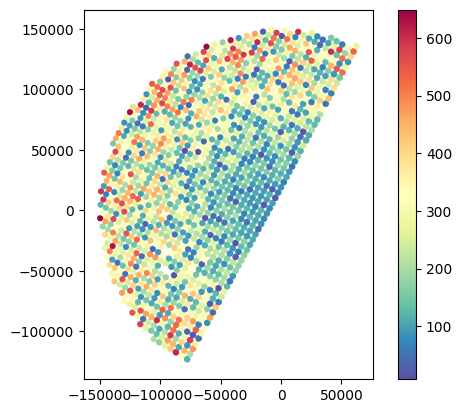

In [ ]:
gdf_gr_match.plot(column="distance_horizontal_max", legend=True, cmap="Spectral_r")
gdf_gr_match.plot(column="distance_horizontal_mean", legend=True, cmap="Spectral_r")
gdf_gr_match.plot(column="distance_horizontal_min", legend=True, cmap="Spectral_r")

<Axes: >

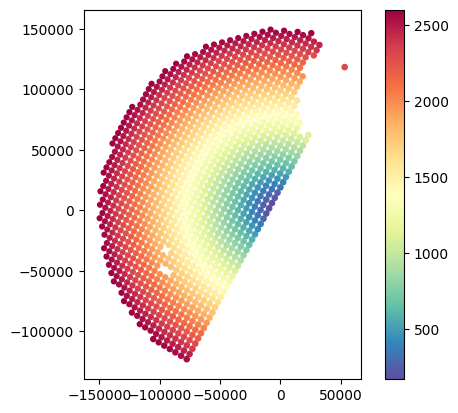

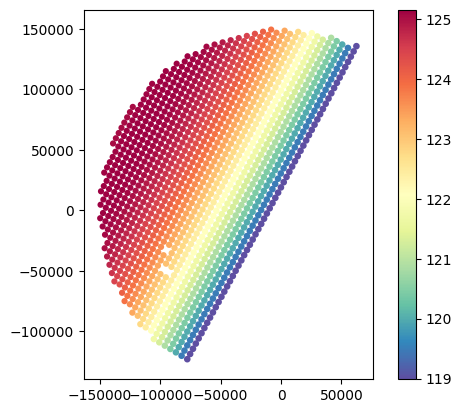

In [ ]:
# Analyse variations in gate resolution
gdf_match.plot(column="GR_vres_mean", legend=True, cmap="Spectral_r")
gdf_match.plot(column="SR_vres_mean", legend=True, cmap="Spectral_r")

<Axes: >

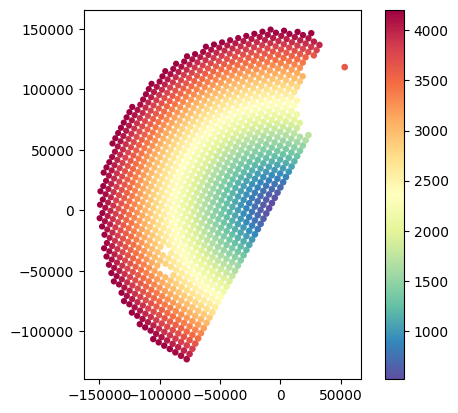

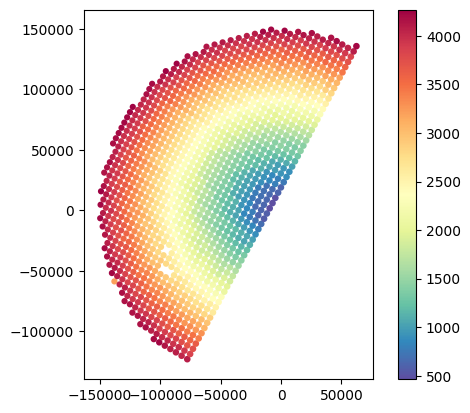

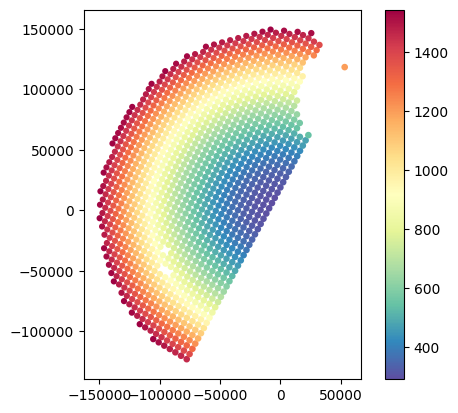

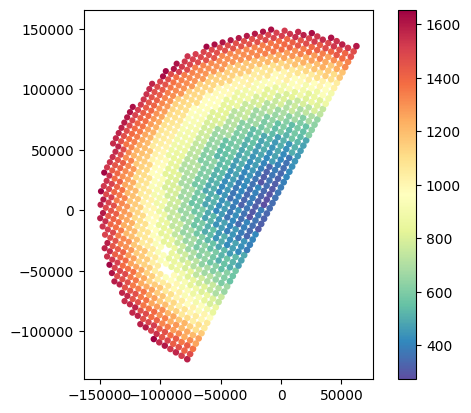

In [ ]:
# Analyse variations in minimum and maximum gate elevation
gdf_match.plot(column="GR_z_upper_bound", legend=True, cmap="Spectral_r")
gdf_match.plot(column="SR_z_upper_bound", legend=True, cmap="Spectral_r")

gdf_match.plot(column="GR_z_lower_bound", legend=True, cmap="Spectral_r")
gdf_match.plot(column="SR_z_lower_bound", legend=True, cmap="Spectral_r")

<Axes: >

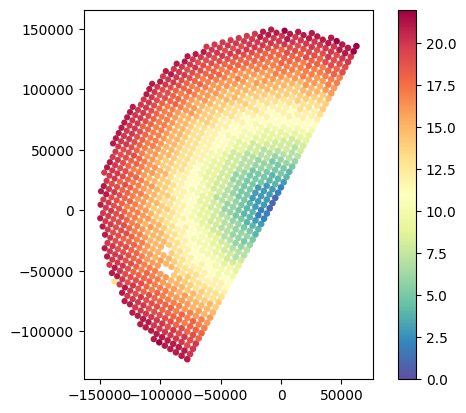

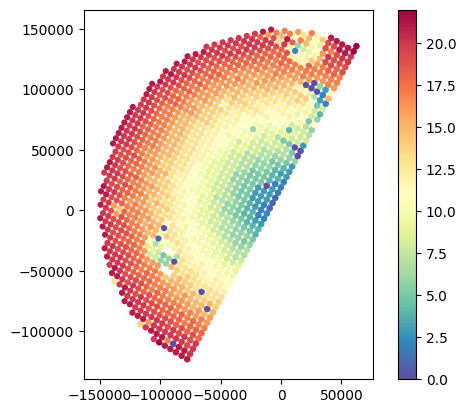

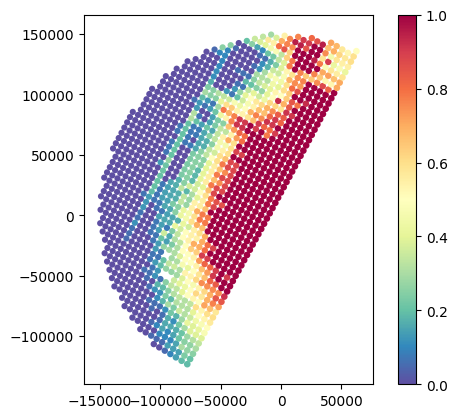

In [ ]:
# Analyse fraction hydrometeors and sensitivity
gdf_match.plot(column="SR_counts", legend=True, cmap="Spectral_r", vmin=0)
gdf_match.plot(column="SR_counts_valid", legend=True, cmap="Spectral_r", vmin=0)

gdf_match.plot(column="SR_fraction_clutter", legend=True, cmap="Spectral_r", vmin=0, vmax=1)

# gdf_match.plot(column="SR_fraction_melting_layer", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_fraction_hail", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_fraction_snow", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_fraction_rain", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_fraction_no_precip", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_fraction_below_isotherm", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_fraction_above_isotherm", legend=True, cmap="Spectral_r", vmin=0, vmax=1)

<Axes: >

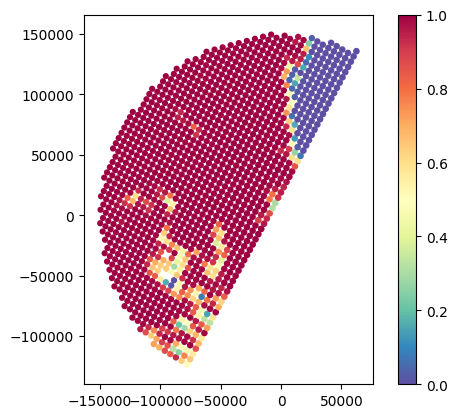

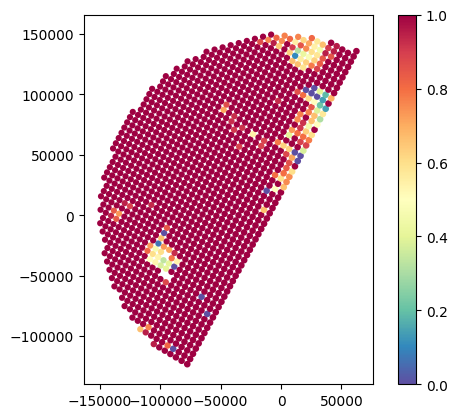

In [ ]:
# Analyse sensitivity
gdf_match.plot(column="GR_Z_fraction_above_10dBZ", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="GR_Z_fraction_above_12dBZ", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="GR_Z_fraction_above_14dBZ", legend=True, cmap="Spectral_r", vmin=0, vmax=1)

gdf_match.plot(column="SR_zFactorFinal_Ku_fraction_above_12dBZ", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_zFactorFinal_Ku_fraction_above_14dBZ", legend=True, cmap="Spectral_r", vmin=0, vmax=1)
# gdf_match.plot(column="SR_zFactorFinal_Ku_fraction_above_16dBZ", legend=True, cmap="Spectral_r", vmin=0, vmax=1)

<Axes: >

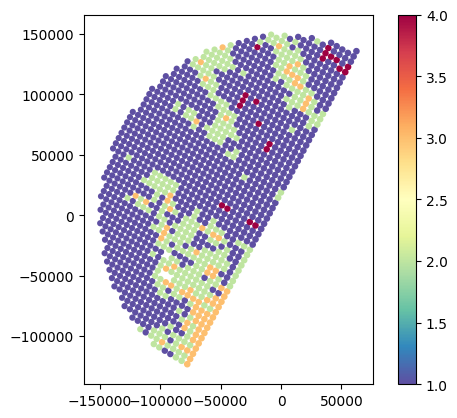

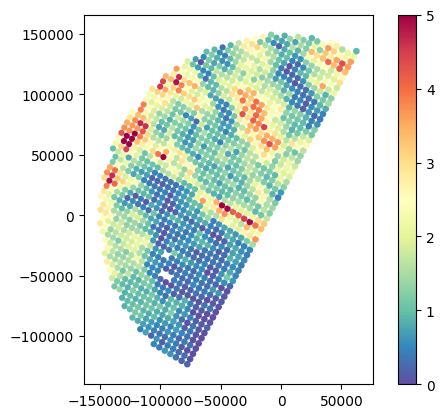

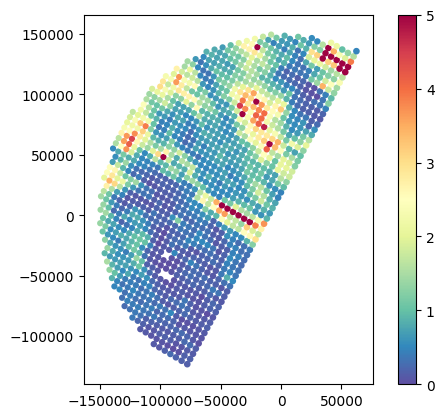

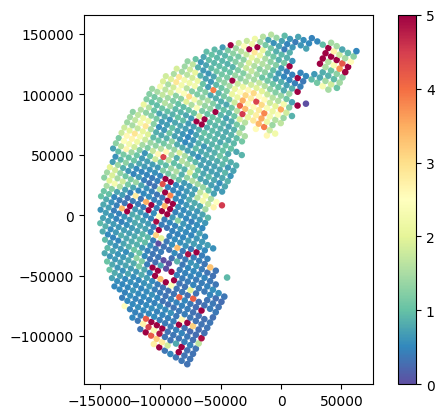

In [ ]:
# Analyse SR attenuation statistics
gdf_match.plot(column="SR_reliabFlag", legend=True, cmap="Spectral_r")
gdf_match.plot(column="SR_pathAtten", legend=True, cmap="Spectral_r", vmin=0, vmax=5)
gdf_match.plot(column="SR_piaFinal", legend=True, cmap="Spectral_r", vmin=0, vmax=5)
gdf_match.plot(column="SR_zFactorCorrection_Ku_max", legend=True, cmap="Spectral_r", vmin=0, vmax=5)

<Axes: >

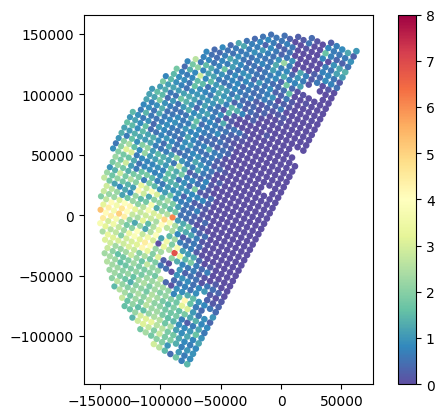

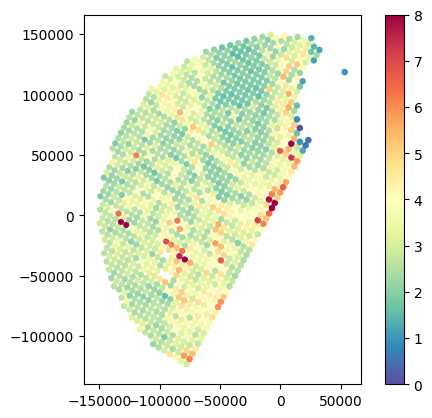

In [ ]:
# Analyse SR NUBF
gdf_match.plot(column="SR_zFactorFinal_Ku_std", legend=True, cmap="Spectral_r", vmin=0, vmax=8)
gdf_match.plot(column="GR_Z_std", legend=True, cmap="Spectral_r", vmin=0, vmax=8)

# gdf_match.plot(column="SR_zFactorFinal_Ku_range", legend=True, cmap="Spectral_r", vmin=0, vmax=8)
# gdf_match.plot(column="GR_Z_range", legend=True, cmap="Spectral_r", vmin=0, vmax=20)

# gdf_match.plot(column="SR_zFactorFinal_Ku_cov", legend=True, cmap="Spectral_r")
# gdf_match.plot(column="GR_Z_cov", legend=True, cmap="Spectral_r")

# gdf_match["SR_zFactorFinal_Ku_range_rel"] = gdf_match["SR_zFactorFinal_Ku_range"]/gdf_match["SR_zFactorFinal_Ku_mean"]
# gdf_match.plot(column="SR_zFactorFinal_Ku_range_rel", legend=True, cmap="Spectral_r", vmin=0, vmax=1)

# gdf_match["GR_Z_range_rel"] = gdf_match["GR_Z_range"]/gdf_match["GR_Z_mean"]
# gdf_match.plot(column="GR_Z_range_rel", legend=True, cmap="Spectral_r")

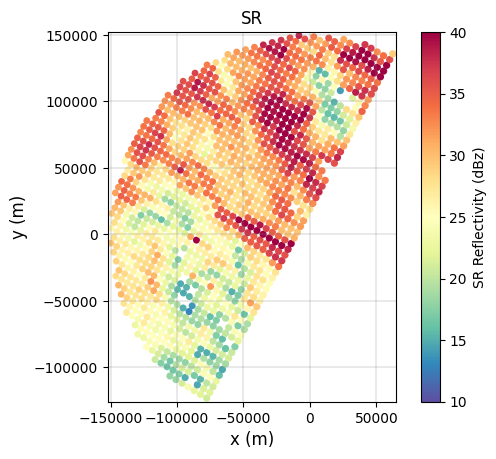

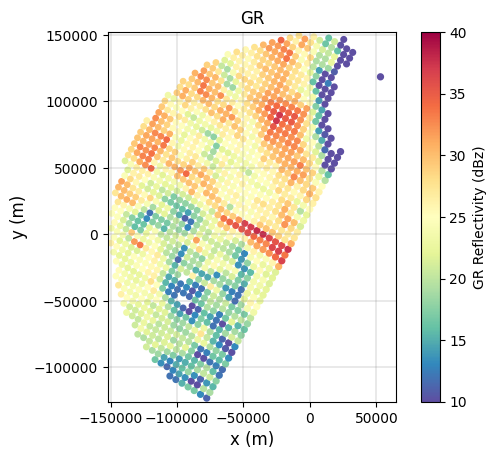

In [ ]:
# Compare reflectivities
extent_xy = gdf_sr.total_bounds[[0, 2, 1, 3]]
p = gdf_match.plot(
    column="SR_zFactorFinal_Ku_mean",
    legend=True,
    legend_kwds={"label": "SR Reflectivity (dBz)"},
    cmap="Spectral_r",
    vmin=10,
    vmax=40,
)
p.axes.set_xlim(extent_xy[0:2])
p.axes.set_ylim(extent_xy[2:4])
p.axes.set_title("SR")
plt.xlabel("x (m)", fontsize=12)
plt.ylabel("y (m)", fontsize=12)
plt.grid(lw=0.25, color="grey")

p = gdf_match.plot(
    column="GR_Z_mean",
    legend=True,
    legend_kwds={"label": "GR Reflectivity (dBz)"},
    cmap="Spectral_r",
    vmin=10,
    vmax=40,
)
p.axes.set_xlim(extent_xy[0:2])
p.axes.set_ylim(extent_xy[2:4])
p.axes.set_title("GR")
plt.xlabel("x (m)", fontsize=12)
plt.ylabel("y (m)", fontsize=12)
plt.grid(lw=0.25, color="grey")

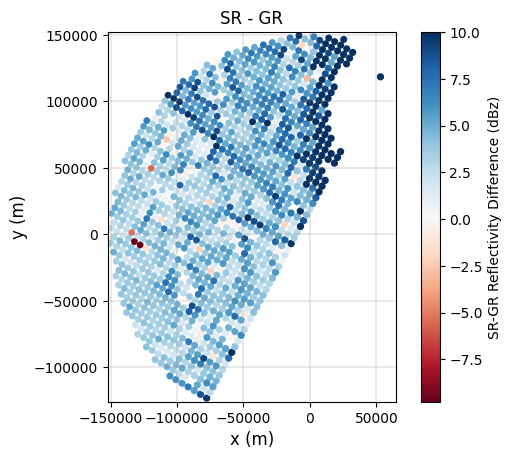

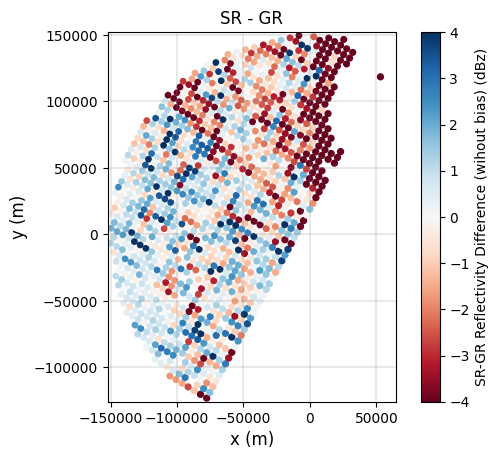

In [ ]:
# Compute difference (also with bias removed)
gdf_match["DIFF_Z_SR_GR"] = gdf_match["SR_zFactorFinal_Ku_mean"] - gdf_match["GR_Z_mean"]
gdf_match["DIFF_Z_GR_SR"] = gdf_match["GR_Z_mean"] - gdf_match["SR_zFactorFinal_Ku_mean"]
bias_gr_sr = np.nanmedian(gdf_match["DIFF_Z_GR_SR"]).round(2)
bias_sr_gr = np.nanmedian(gdf_match["DIFF_Z_SR_GR"]).round(2)
p = gdf_match.plot(
    column="DIFF_Z_SR_GR",
    legend_kwds={"label": "SR-GR Reflectivity Difference (dBz)"},
    cmap="RdBu",
    legend=True,
    vmax=10,
)
p.axes.set_xlim(extent_xy[0:2])
p.axes.set_ylim(extent_xy[2:4])
p.axes.set_title("SR - GR")
plt.xlabel("x (m)", fontsize=12)
plt.ylabel("y (m)", fontsize=12)
plt.grid(lw=0.25, color="grey")

gdf_match["DIFF_Z_GR_SR_unbiased"] = gdf_match["DIFF_Z_GR_SR"] - bias_gr_sr
p = gdf_match.plot(
    column="DIFF_Z_GR_SR_unbiased",
    legend_kwds={"label": "SR-GR Reflectivity Difference (wihout bias) (dBz)"},
    cmap="RdBu",
    legend=True,
    vmin=-4,
    vmax=4,
)
p.axes.set_xlim(extent_xy[0:2])
p.axes.set_ylim(extent_xy[2:4])
p.axes.set_title("SR - GR")
plt.xlabel("x (m)", fontsize=12)
plt.ylabel("y (m)", fontsize=12)
plt.grid(lw=0.25, color="grey")

-----
Here we show how to explore interactively the reflectivity fields using Folium:

In [ ]:
gdf_match1 = gdf_match.copy()
gdf_match1 = gdf_match1.drop(columns="time_difference")  # to avoid bug with timedelta JSON serializer in folium
gdf_match1.explore(column="GR_Z_mean", legend=True, cmap="Spectral_r", vmin=0, vmax=40)

-----
Here we show how to plot cartopy maps in WGS84 and GR CRS AEQD.

In [ ]:
# Define Cartopy AEQD CRS
ccrs_aeqd = ccrs.AzimuthalEquidistant(
    central_longitude=ds_gr["longitude"].item(),
    central_latitude=ds_gr["latitude"].item(),
)

In [ ]:
# Define Cartopy WGS84 CRS
ccrs_wgs84 = ccrs.PlateCarree()

In [ ]:
# Print CRS of geopandas geometries
gdf_match.crs

<Projected CRS: PROJCRS["unknown",BASEGEOGCRS["unknown",DATUM["Wor ...>
Name: unknown
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unknown
- method: Modified Azimuthal Equidistant
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<GeoAxes: >

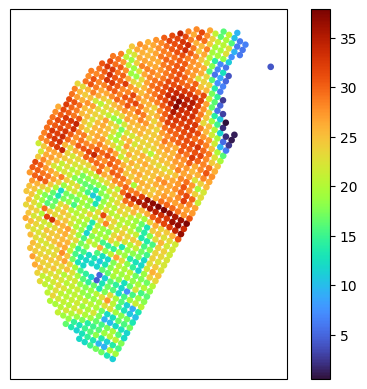

In [ ]:
# Plot in AEQD CRS (same crs of geopandas geometries)
fig, ax = plt.subplots(subplot_kw={"projection": ccrs_aeqd})
gdf_match.plot(ax=ax, column="GR_Z_mean", cmap="turbo", legend=True)

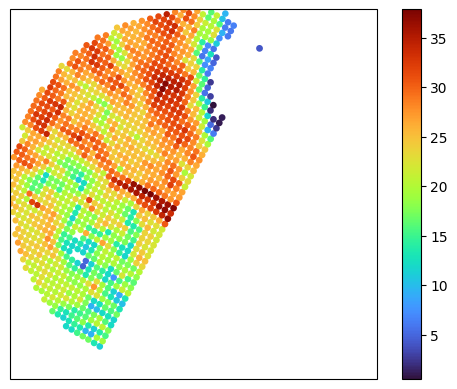

In [ ]:
# Convert geopandas dataframe to another crs
gdf_match_wgs84 = gdf_match.to_crs(crs_sr)

# Plot in WGS84 CRS
fig, ax = plt.subplots(subplot_kw={"projection": ccrs_wgs84})
# plot_cartopy_background(ax)
gdf_match_wgs84.plot(ax=ax, column="GR_Z_mean", cmap="turbo", legend=True)
ax.set_extent(ds_gr.xradar_dev.extent(max_distance=max_gr_range))

## Filter the SR/GR Database

When calibrating or comparing SR and GR data, there is a necessary tradeoff between the strictness of filtering criteria filtering and the number of available samples. Here below we provide some general recommendations for effective filtering:

1. **Sensitivity Thresholds**: Retain only those radar beams where the aggregated gate reflectivities exceed the instrument sensitivities.
The `GR_Z_fraction_above_<thr>dBZ` and `SR_zFactorFinal_Ku_fraction_above_<thr>dBZ` variables can be used filter the samples.

2. **Stratiform Precipitation**:  If the purpose of your analysis is to assess the calibration bias of GR data, it is suggested to focus on stratiform precipitation that ocurrs outside the melting layer (i.e. avoiding the bright band). Only stratiform samples above the melting layer are used in ground validation of the GPM DPR (W. Petersen 2017, personal communication).
Convective SR footprints are typically excluded to avoid dealing with:
- the high spatial variability in the precipitation field and issues with non-uniform beam filling (NUBF),
- the potential biases introduced by the SR attenuation correction,
- the potential biases in GR reflectivities, especially at C and X band, due to beam attenuation,
- the multiple scattering signature caused by hail particles.

5. **Reflectivity Range**: According to Warren et al. (2018), volume-averaged SR and GR reflectivity values should be selected within the range of 24 to 36 dBZ. This range minimizes the impact of low SR sensitivity,  SR beam attenuation and non-rayleigh scattering effects.
 
7. **Clutter Removal**: Exclude SR/GR samples that are contaminated by ground clutter, anomalous propagation, or beam blockage. 

8. **Volume matching**: Exclude SR/GR samples where there are excessive differences in the total gate volume.


In [ ]:
# Define mask
masks = [
    # Select SR scan with "normal" dataQuality (for entire cross-track scan)
    gdf_match["SR_dataQuality"] == 0,
    # Select SR beams with detected precipitation
    gdf_match["SR_flagPrecip"] > 0,
    # Select only 'high quality' SR data
    # - qualityFlag == 1 indicates low quality retrievals
    # - qualityFlag == 2 indicates bad/missing retrievals
    gdf_match["SR_qualityFlag"] == 0,
    # Select SR beams with SR above minimum reflectivity
    gdf_match["SR_zFactorFinal_Ku_fraction_above_12dBZ"] > 0.95,
    # Select SR beams with GR above minimum reflectivity
    gdf_match["GR_Z_fraction_above_10dBZ"] > 0.95,
    # Select only SR beams with detected bright band
    gdf_match["SR_qualityBB"] == 1,
    # Select only beams with confident precipitation type
    gdf_match["SR_qualityTypePrecip"] == 1,
    # Select only stratiform precipitation
    # - SR_flagPrecipitationType == 2 indicates convective
    gdf_match["SR_flagPrecipitationType"] == 1,
    # Select only SR beams with reliable attenuation correction
    gdf_match["SR_reliabFlag"].isin((1, 2)),  # or == 1
    # Select only beams with reduced path attenuation
    # gdf_match["SR_zFactorCorrection_Ku_max"]
    # gdf_match["SR_piaFinal"]
    # gdf_match["SR_pathAtten"]
    # Select only SR beams with matching SR gates with no clutter
    gdf_match["SR_fraction_clutter"] == 0,
    # Select only SR beams with matching SR gates not in the melting layer
    gdf_match["SR_fraction_melting_layer"] == 0,
    # Select only SR beams with matching SR gates with precipitation
    gdf_match["SR_fraction_no_precip"] == 0,
    # Select only SR beams with matching SR gates with no hail
    # gdf_match["SR_fraction_hail"] == 0,
    # Select only SR beams with matching SR gates with rain
    # gdf_match["SR_fraction_hail"] == 1,
    # Select only SR beams with matching SR gates with snow
    # gdf_match["SR_fraction_snow"] == 1,
    # Discard SR beams with high NUBF
    # gdf_match["SR_zFactorFinal_Ku_range"] > 5,
    # gdf_match["SR_zFactorFinal_Ku_cov"] < 0.5,
    # gdf_match["GR_Z_cov"] < 0.5,
    # gdf_match["GR_Z_range"] > 5,
    # Select only interval of reflectivities
    # - Warren et al., 2018:  between 24 and 36 dBZ
    # (gdf_match["SR_zFactorFinal_Ku_mean"] > 24) & (gdf_match["SR_zFactorFinal_Ku_mean"] < 36),
    # (gdf_match["GR_Z_mean"] > 24) & (gdf_match["GR_Z_mean"] < 36),
    # Select SR beams only within given GR radius interval
    # (gdf_match["GR_range_min"] > min_gr_range) & (gdf_match["GR_range_max"] < max_gr_range),
    # Discard SR beams where scanning time difference > 5 minutes
    gdf_match["time_difference"] < np.timedelta64(5, "m"),
    # Discard SR beams where GR gates does not cover 80% of the horizontal area
    # gdf_match["GR_fraction_covered_area"] > 0.8,
    # Filter footprints where volume ratio exceeds 60
    # gdf_match["VolumeRatio"] > 60,
    # Filter footprints where GR affected by beam blockage
    # TODO: Filtering by beam blockage
]

In [ ]:
# Define final mask
mask_final = reduce(np.logical_and, masks)

<Axes: >

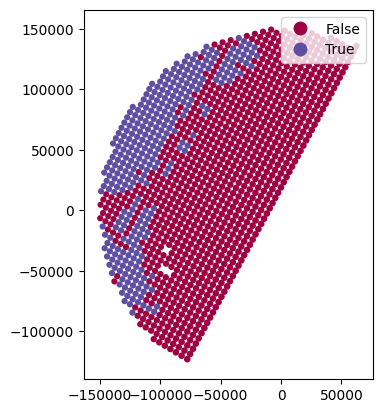

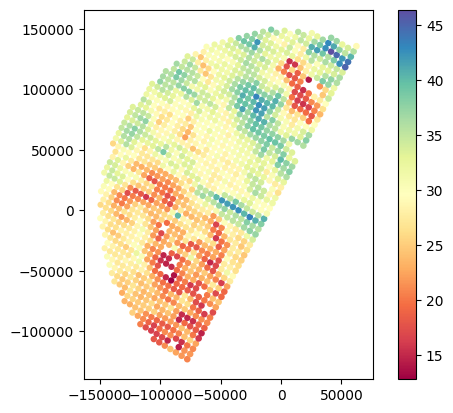

In [ ]:
# Dsplay final filtering mask
gdf_match["filtering_mask"] = mask_final
gdf_match.plot(column="filtering_mask", legend=True, cmap="Spectral")
gdf_match.plot(column="SR_zFactorFinal_Ku_mean", legend=True, cmap="Spectral")

In [ ]:
# Filter matching dataset
gdf_final = gdf_match[mask_final]

<Axes: >

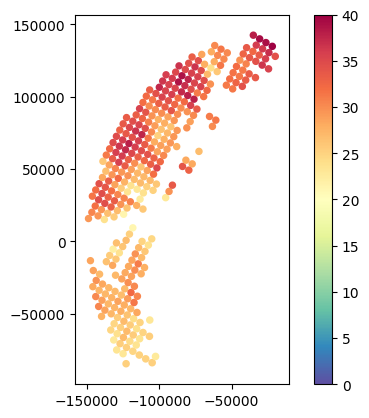

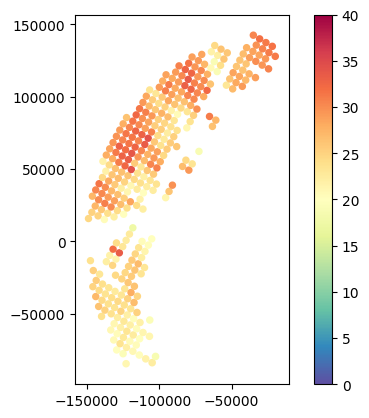

In [ ]:
# Plot results
gdf_final.plot(column="SR_zFactorFinal_Ku_mean", legend=True, cmap="Spectral_r", vmin=0, vmax=40)
gdf_final.plot(column="GR_Z_mean", legend=True, cmap="Spectral_r", vmin=0, vmax=40)

## Determine the GR Calibration Bias

In [ ]:
# Compute statistics
bias = np.nanmean(gdf_match["DIFF_Z_GR_SR"]).round(2)
robBias = np.nanmedian(gdf_match["DIFF_Z_GR_SR"]).round(2)

# R2 (pearson, spearman rank)
print(f"Th ZH Calibration offset is (mean): {bias} dB")
print(f"Th ZH Calibration offset is (median): {robBias} dB")

Th ZH Calibration offset is (mean): -5.14 dB
Th ZH Calibration offset is (median): -4.36 dB


In [ ]:
# Comparison of GR vs SR reflectivities
hue_variable = "VolumeDiff"
hue_title = "Difference in volume between SR and GR [m³]"

Text(0.5, 0.98, 'GR vs SR')

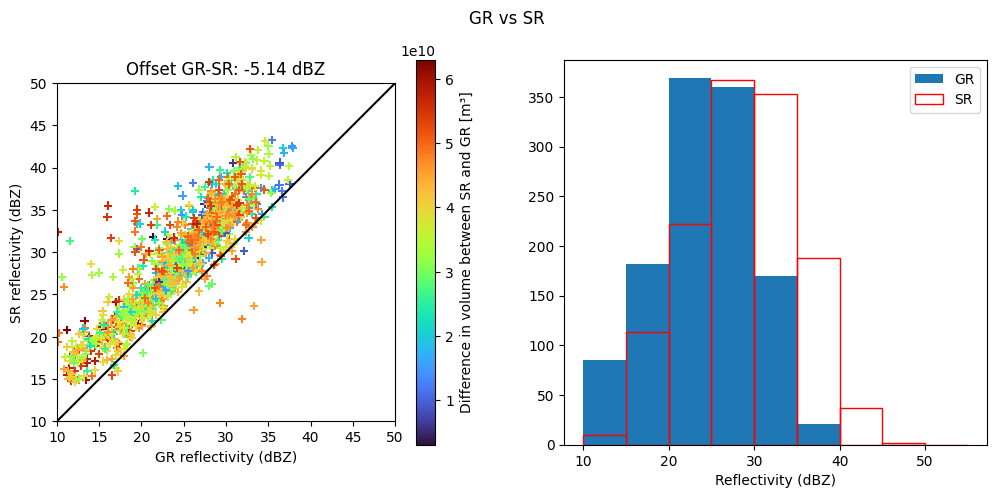

In [ ]:
# - Histograms
fig = plt.figure(figsize=(12, 5))
ax = fig.add_subplot(121, aspect="equal")
plt.scatter(
    gdf_match["GR_Z_mean"],
    gdf_match["SR_zFactorFinal_Ku_mean"],
    marker="+",
    c=gdf_match[hue_variable],
    cmap="turbo",
)
plt.colorbar(label=hue_title)
plt.plot([0, 60], [0, 60], linestyle="solid", color="black")
plt.xlim(10, 50)
plt.ylim(10, 50)
plt.xlabel("GR reflectivity (dBZ)")
plt.ylabel("SR reflectivity (dBZ)")
plt.title(f"Offset GR-SR: {bias} dBZ")
ax = fig.add_subplot(122)
plt.hist(
    gdf_match["GR_Z_mean"][gdf_match["GR_Z_mean"] > z_min_threshold_gr],
    bins=np.arange(10, 60, 5),
    edgecolor="None",
    label="GR",
)
plt.hist(
    gdf_match["SR_zFactorFinal_Ku_mean"][gdf_match["SR_zFactorFinal_Ku_mean"] > z_min_threshold_sr],
    bins=np.arange(10, 60, 5),
    edgecolor="red",
    facecolor="None",
    label="SR",
)
plt.xlabel("Reflectivity (dBZ)")
plt.legend()
fig.suptitle("GR vs SR")

## Next Steps 

Congratulations on reaching the end of this tutorial!
If you have suggestions for improving this tutorial or the SR/GR matching process, please feel free to open
a Pull Request or create a GitHub issue on the [GPM-API GitHub repository](https://github.com/ghiggi/gpm_api).

The code for the SR/GR matching process is encapsulated in the `volume_matching` function contained in the [gpm.utils.gv module](https://github.com/ghiggi/gpm_api/blob/main/gpm/utils/gv.py) . User are free to use or adapt such function to accomplish their tasks. 
The [Spaceborne-Ground Radar Calibration Applied Tutorial](
https://gpm-api.readthedocs.io/en/latest/tutorials/tutorial_03_SR_GR_Calibration.html) shows how to assess the GR calibration bias by abstracting away the complexities discussed in this tutorial.                                                                       

## References

- [Cao, Q., Y. Hong, Y. Qi, Y. Wen, J. Zhang, J. J. Gourley, and L. Liao, 2013: Empirical conversion of the vertical profile of reflectivity from Ku-band to S-band frequency. J. Geophys. Res. Atmos., 118, 1814–1825, https://doi.org/10.1002/jgrd.50138](https://doi.org/10.1002/jgrd.50138)
- [Schwaller, MR, and Morris, KR. 2011. A ground validation network for the Global Precipitation Measurement mission. J. Atmos. Oceanic Technol., 28, 301-319.28, https://doi.org/10.1175/2010JTECHA1403.1](https://doi.org/10.1175/2010JTECHA1403.1)
- [Warren, R.A., A. Protat, S.T. Siems, H.A. Ramsay, V. Louf, M.J. Manton, and T.A. Kane, 2018. Calibrating ground-based radars against TRMM and GPM. J. Atmos. Oceanic Technol., 35, 323–346, https://doi.org/10.1175/JTECH-D-17-0128.1](https://doi.org/10.1175/JTECH-D-17-0128.1)

## Citation

This notebook is part of the [GPM-API  documentation](https://gpm-api.readthedocs.io/).

Large portions of this tutorials were adapted and derived from an old $\omega radlib$  tutorial.

Copyright: $\omega radlib$  and GPM-API developers.
Distributed under the MIT License. See [GPM-API license](https://github.com/ghiggi/gpm_api/blob/main/LICENSE) for more info.